In [4]:
import imageio
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
import re
from scipy import ndimage
import math

def extract_number_from_filename(filename):
    # Use regular expression to extract numbers from the filename
    match = re.search(r'([+-]?\d+)', filename)
    number = int(match.group()) if match else None

    # Check if "m" is followed by any number and return the negative value
    if "m" in filename and number is not None:
        return -number
    else:
        return number

def extract_number_from_tiff_filename(filename):
    # Extract numbers from a filename that comprises only of the number and .tiff suffix
    match = re.match(r'([+-]?\d+).tiff', filename)
    return int(match.group(1)) if match else None

def find_peak_and_sum(image, radius, circle_radii):
    # Smooth the image to enhance peak detection
    smoothed_image = ndimage.gaussian_filter(image, sigma=2)

    # Find the peak location in the smoothed image
    peak_location = np.unravel_index(np.argmax(smoothed_image), smoothed_image.shape)

    # Create a circular mask centered around the peak location
    y, x = np.ogrid[:image.shape[0], :image.shape[1]]
    circular_mask = ((x - peak_location[1])**2 + (y - peak_location[0])**2 <= radius**2)

    # Background subtraction
    #background = np.mean(image[~circular_mask])
    background = np.mean(image[0:300][0:300])
    image_subtracted = image - background
    image_subtracted[image_subtracted < 0] = 0 #replace negative values by zero

    # Dictionary to store results
    results = {}

    # Loop over each specified circle radius
    for i, circle_radius in enumerate(circle_radii, start=0):
        # Create a circular mask for the current circle radius
        circle_mask = ((x - peak_location[1])**2 + (y - peak_location[0])**2 <= circle_radius**2)

        # Check if it's the first circle (center)
        if i == 0:
            # Calculate the intensity sum within the center
            sum_in_center = np.sum(image_subtracted[circle_mask])
            results[f"Center_{i+1}"] = sum_in_center

            # save the max value from the central circle (in the default -pixelcount- units)
            results[f"Center_peak"] = np.amax(image_subtracted[circle_mask])
        else:
            # Create an annulus mask between the current and previous circle radii
            annulus_mask = circle_mask & ~prev_circle_mask

            # Calculate the intensity sum within the annulus
            sum_in_annulus = np.sum(image_subtracted[annulus_mask])
            results[f"Annulus_{i}"] = sum_in_annulus

        # Store the current circle mask for the next iteration
        prev_circle_mask = circle_mask

    return peak_location, results

def plot_circles(peak_location, circle_radii, ax):
    # Plot the circles
    for i, circle_radius in enumerate(circle_radii, start=1):
        #color = plt.cm.tab10(i)  # Get a unique color for each circle
        color ='black'
        circle = plt.Circle((peak_location[1], peak_location[0]), circle_radius, color=color, fill=False, label=f"Circle {i}",linewidth=0.5,linestyle='dashed')
        ax.add_patch(circle)

def plot_intensity_vs_radial_position(cropped_region, dx, ax):
    # Calculate the radial position for each column in the cropped region in microns
    radial_positions_microns = np.arange(-cropped_region.shape[1] // 2, cropped_region.shape[1] // 2) * dx * 1e6  # Convert to microns

    # Calculate the intensity along the horizontal axis through the center
    half = int(cropped_region.shape[0]/2)
    intensity_profile = cropped_region[half]

    from scipy.optimize import curve_fit
    from scipy.special import jv
    # Define the square function to fit
    def square_bessel_function(x, a, b,c):
        return a * np.square(jv(0, b*x))+c

    # Generate some sample data
    x_data = radial_positions_microns
    y_data = intensity_profile  # Square of zeroth order Bessel function of the first kind

    # Fit the square function to the data
    popt, pcov = curve_fit(square_bessel_function, x_data, y_data,maxfev=1800)

    # Plot intensity vs radial position
    ax.plot(radial_positions_microns, intensity_profile, label='data')
    ax.plot(x_data, square_bessel_function(x_data, *popt), color='red', label=r'Fit $J_0^2(k\alpha\rho)$')
    ax.axhline(y=255,color='black',linestyle='dashed',linewidth=1)
    ax.set_xlabel('Radial Position (µm)')  # Adjust the label to include microns
    ax.set_ylabel('Intensity')
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position("right")
    ax.set_title('Intensity vs Radial Position through the Center')
    ax.legend(loc='upper right')
    return popt[0] #return the peak (amplitude) of the fitted squared bessel function

def change_ticks(data=object,pixsize=float,axis=object,change_X=bool,change_Y=bool):
    (nrows,ncols)=data.shape
    N_x=math.floor(ncols*pixsize/10) #max integer number of tens of microns that fit into the horizontal axis
    N_y=math.floor(nrows*pixsize/10) #max integer number of tens of microns that fit into the vertical axis
    new_xticks=np.around(np.linspace(0,N_x*10,N_x+1),decimals=0) #generate a list of integer ticks for the horizontal axis
    new_xticks = [int(x) for x in new_xticks]
    new_yticks=np.around(np.linspace(0,N_y*10,N_y+1),decimals=0) #generate a list of integer ticks for the vertical axis
    new_yticks = [int(x) for x in new_yticks]
    #find horizontal locations (in pixels) corresponding to the desired tick locations (given in mm), rounded to the nearest pixel:
    new_xtick_locations = np.around(np.array(new_xticks)/pixsize,decimals=0).astype(int) #also, cast into integers
    #find vertical locations (in pixels) corresponding to the desired tick locations (given in mm), rounded to the nearest pixel:
    new_ytick_locations = np.around(np.array(new_yticks)/pixsize,decimals=0).astype(int) #also, cast into integers
    if change_X:
        axis.set_xticks(new_xtick_locations,new_xticks) #set the horizontal axis ticks
        axis.set_xlabel('X [microns]')
    if change_Y:
        axis.set_yticks(new_ytick_locations,new_yticks) #set the vertical axis ticks
        axis.set_ylabel('Y [microns]')
    return


def show_tiff_images_with_sum_and_numbers(folder_path, radius, circle_radii):
    try:
        # Get all TIFF files in the folder, excluding files starting with '._'
        tiff_files = [file for file in Path(folder_path).glob("*.tif*") if not file.name.startswith('._')]

        if not tiff_files:
            print("No TIFF files found in the specified folder.")
            return

        # Array to store extracted numbers and results
        extracted_numbers = []
        all_results = []

        # Display each TIFF image with circular region and calculate the intensity sum
        for tiff_file in tiff_files:
            # Read the image
            image = imageio.imread(tiff_file)

            # Find peak location and calculate intensity sum for each circle
            peak_location, results = find_peak_and_sum(image, radius, circle_radii)

            # Set up subplots
            fig, axs = plt.subplots(1, 2, figsize=(10, 5))

            # Crop the image around the largest circle
            cropped_image = image[peak_location[0]-radius:peak_location[0]+radius, peak_location[1]-radius:peak_location[1]+radius]

            ##################################

            lambda_0 = 1030e-9 #central wavelength of the laser pulse
            k = 2*np.pi/lambda_0 #wave-vector of the laser
            theta_base = 7*np.pi/180 #base angle of the used axicon [rad]
            eta_axi = 1.45467 #refractive index of the axicon glass (JGS1) at 1030nm
            alpha = np.arcsin(eta_axi*np.sin(theta_base))-theta_base #approach angle of the focusing rays onto the focal line axis
            pixsize = 5.86e-6 #pixel size of the camera [m]
            M = 20 #magnification of the optics used to image the axicon focus
            dx = pixsize/M #distance per pixel [m]

            d_axi = 18e-3 #inner diameter of the axicon [m]
            D_axi = 60e-3 #outer diameter of the beam (it's smaller than the axicon!) [m]
            throughput = 0.78 #energy througput from amplifier to the target
            E_beam = 1330e-3 #energy of the beam (at the amplifier) when the axicon focus was scanned
            E_dD = E_beam*throughput*(1-(d_axi/D_axi)**2) #energy of the beam that actively gets refracted by the axicon (considering the hole)
            dr_axi = (D_axi-d_axi)/2 #thickness of the annular beam

            N_rings = k*alpha*dr_axi/np.pi #the number of Bessel rings present in the beam immediately after the axicon

            N_ROI = len(circle_radii) #number of full rings visible in whats is taken to be the ROI (including the focal spot)

            E_ROI = E_dD*N_ROI/N_rings #energy that should be going through the sensor ROI

            tau = 1e-12 #duration of the laser pulse (assuming square pulse here)
            P_ROI = E_ROI/tau #power going through the ROI
            
            sum_ROI = 0 #sum of all the pixel counts in the ROI
            sum_ROI+=results[f"Center_1"] #add the sum of pixel intensities in the inner circle
            for i in range(len(circle_radii)-1):
                sum_ROI+=results[f"Annulus_{i+1}"] #add the sums of pixel intensities in the surrounding annuli
                print(f"Annulus_{i+1}")

            power_per_pixel_count = P_ROI/sum_ROI #power per pixel count
            I_ppc = power_per_pixel_count/dx**2 *1e-4#intensity per pixel count [W/cm^2]
            results[f"I_ppc"] = I_ppc
            results[f'sum_ROI'] = sum_ROI

            intensity_map = cropped_image*I_ppc

            #############################

            # Display the cropped image with a colorbar
            im = axs[0].imshow(intensity_map, cmap='BuPu',vmin=0,vmax=np.amax(intensity_map))
            
            im = axs[0].imshow(intensity_map/np.amax(intensity_map))
            #axs[0].scatter(int(shape[0]/2),int(shape[1]/2), s=500, c='red', marker='o')
            change_ticks(data=intensity_map,pixsize=dx*1e6,axis=axs[0],change_X=True,change_Y=False)
            axs[0].set_ylabel('Y [pixels]')
            axs[0].set_title(f"{tiff_file.name}")
            fig.colorbar(im, ax=axs[0], fraction=0.05, pad=0.05)  # Add colorbar to the first subplot

            # Plot circles
            plot_circles([radius, radius], circle_radii, axs[0])

            # Plot the intensity vs radial position on the right
            fitted_peak = plot_intensity_vs_radial_position(cropped_image, dx, axs[1])  # Pass dx as an argument
            results['I_peak_bessel'] = fitted_peak

            # Show the subplots for each file
            plt.show()

            # Extract number from filename and append to the array
            number = extract_number_from_filename(tiff_file.stem) or extract_number_from_tiff_filename(tiff_file.name)
            extracted_numbers.append(number)

            # Append results to the array
            all_results.append(results)

        # Get the indices to sort the extracted_numbers array
        sorted_indices = np.argsort(extracted_numbers)

        # Return the extracted numbers array and results array organized according to the sorted indices
        return np.array(extracted_numbers)[sorted_indices], [all_results[i] for i in sorted_indices]

    except Exception as e:
        print(f"Error: {e}")


/var/folders/0_/nrrxny_x54j3w76q939n8pth0000gn/T/ipykernel_2038/4240365136.py:149: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(tiff_file)


Annulus_1
Annulus_2
Annulus_3
Annulus_4


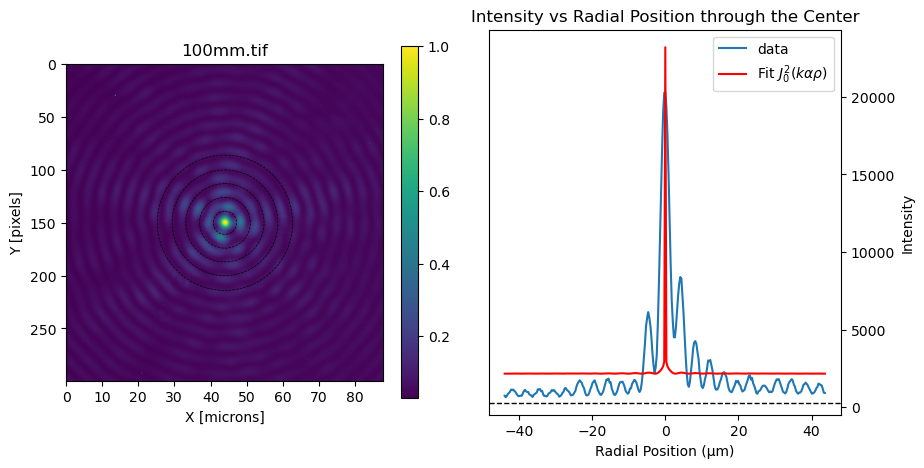

Annulus_1
Annulus_2
Annulus_3
Annulus_4


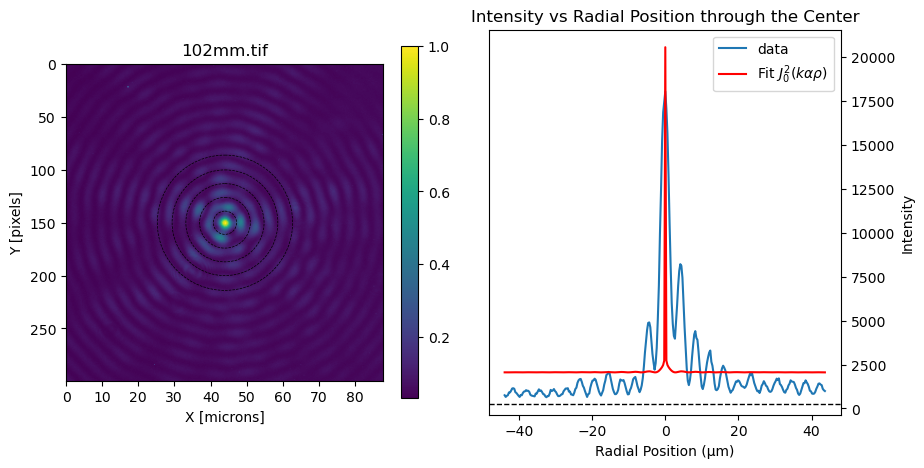

Annulus_1
Annulus_2
Annulus_3
Annulus_4


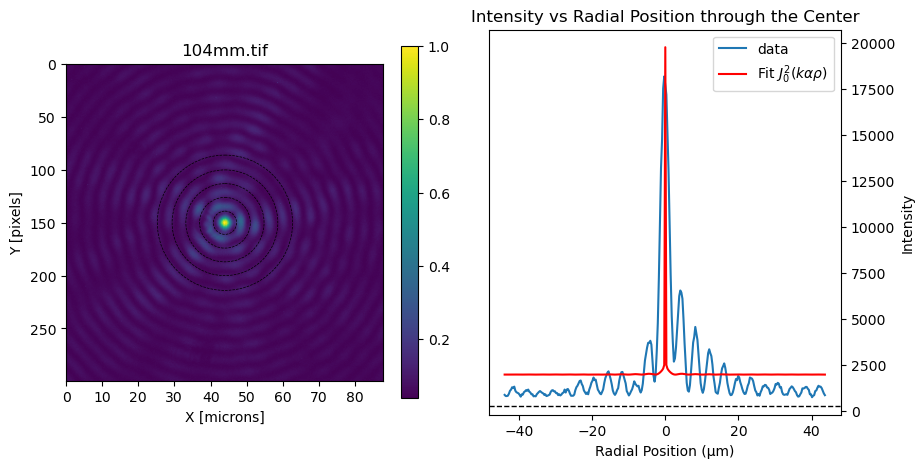

Annulus_1
Annulus_2
Annulus_3
Annulus_4


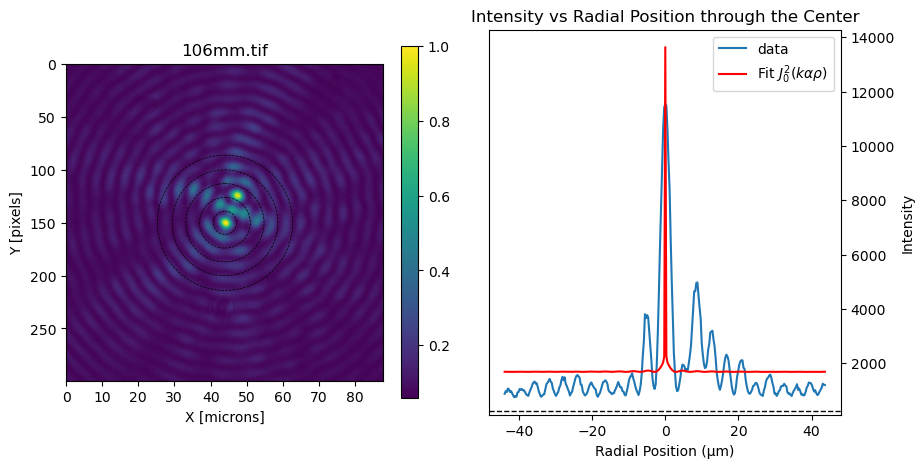

Annulus_1
Annulus_2
Annulus_3
Annulus_4


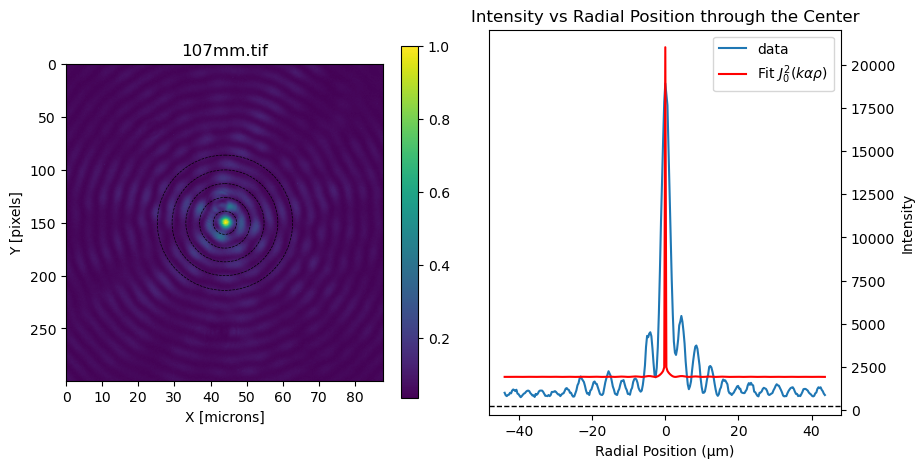

Annulus_1
Annulus_2
Annulus_3
Annulus_4


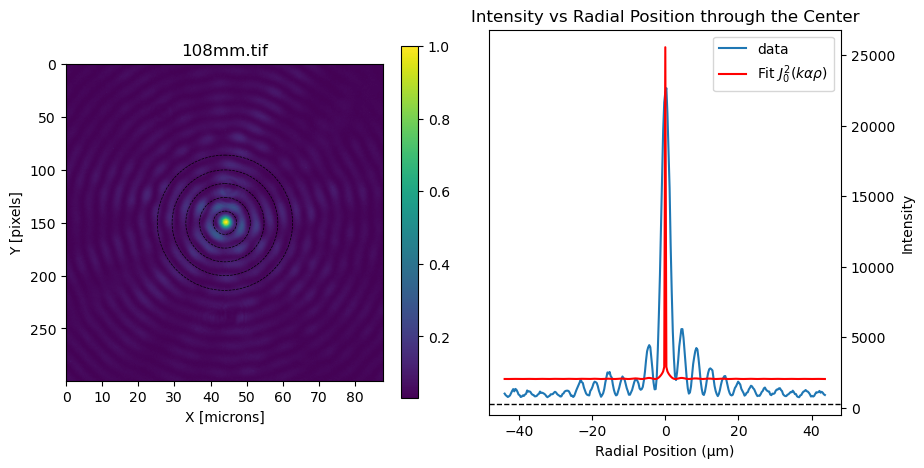

Annulus_1
Annulus_2
Annulus_3
Annulus_4


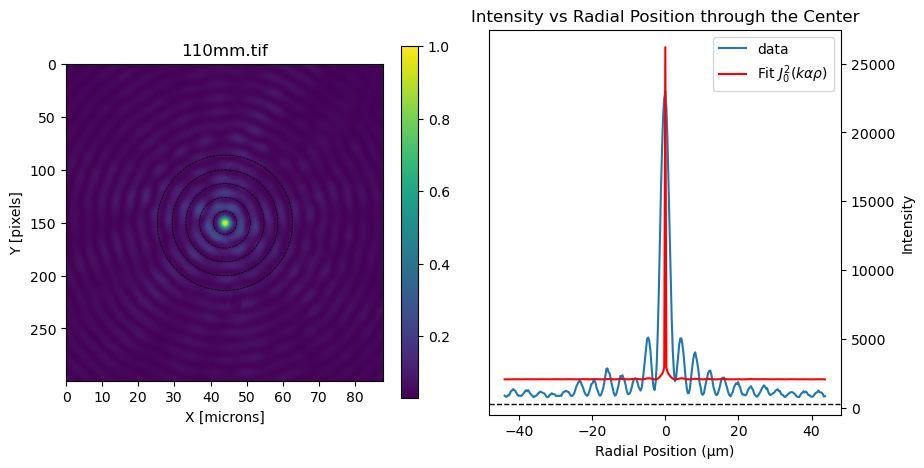

Annulus_1
Annulus_2
Annulus_3
Annulus_4


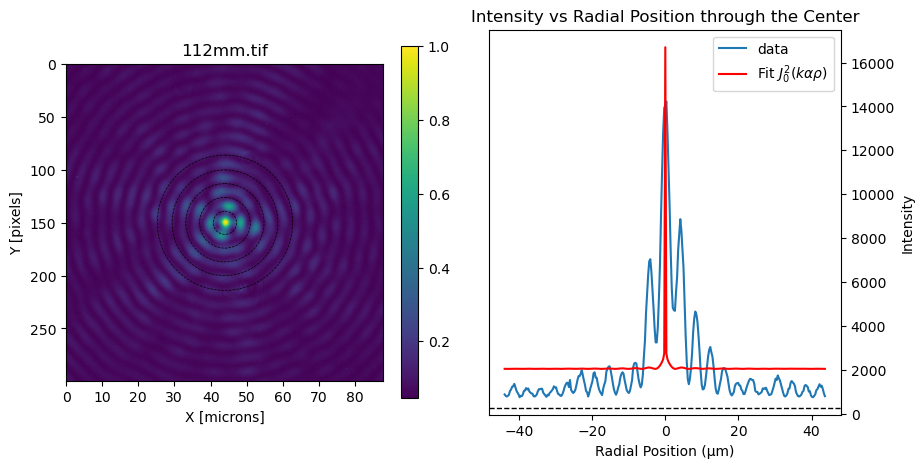

Annulus_1
Annulus_2
Annulus_3
Annulus_4


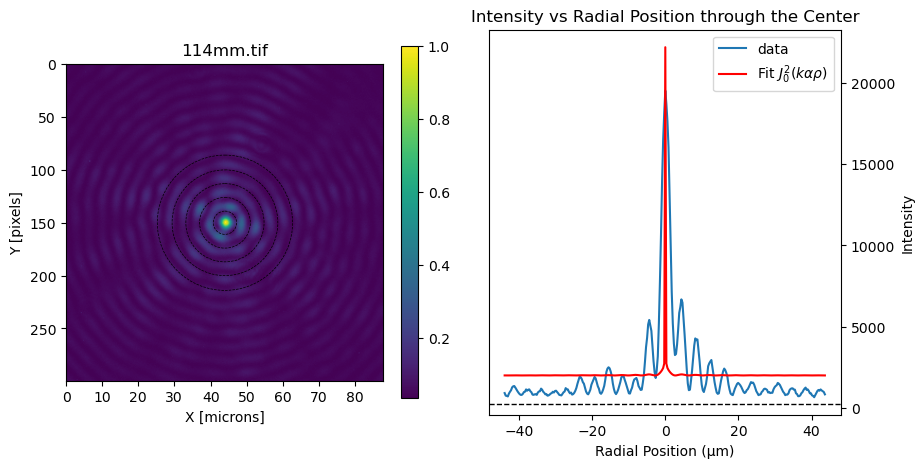

Annulus_1
Annulus_2
Annulus_3
Annulus_4


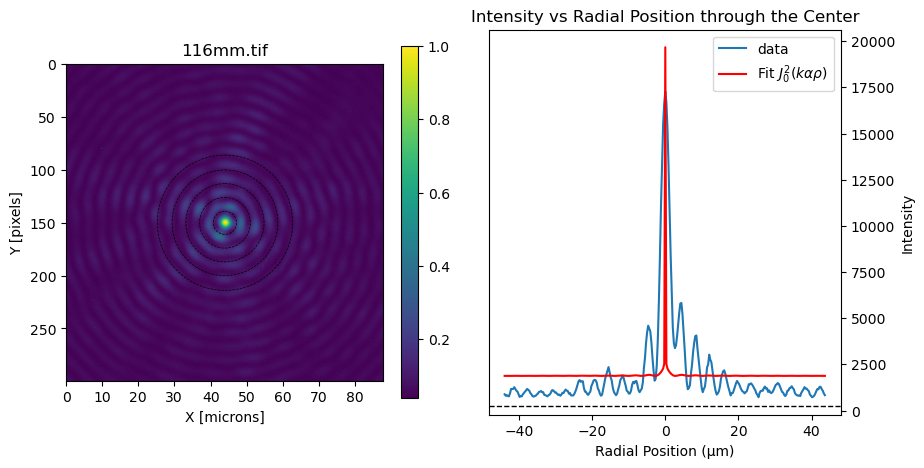

Annulus_1
Annulus_2
Annulus_3
Annulus_4


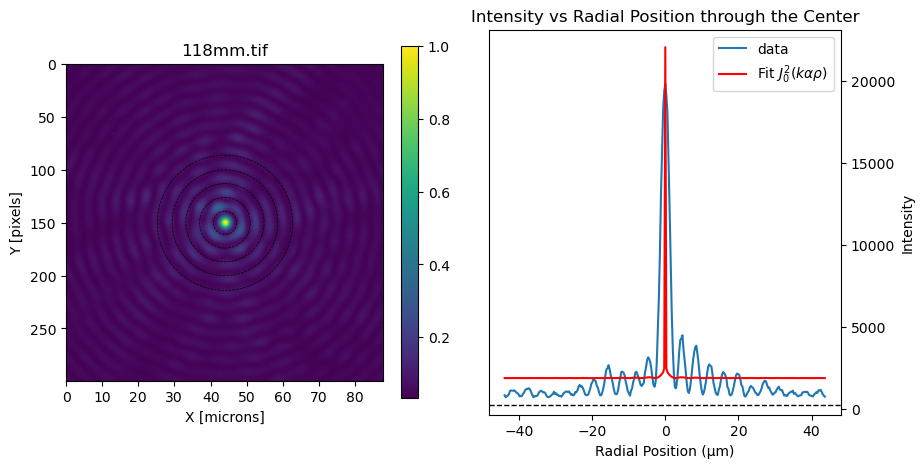

Annulus_1
Annulus_2
Annulus_3
Annulus_4


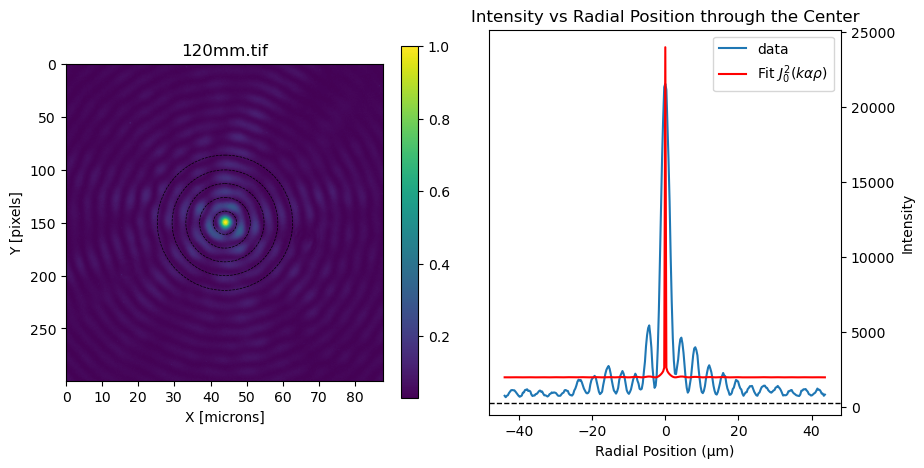

Annulus_1
Annulus_2
Annulus_3
Annulus_4


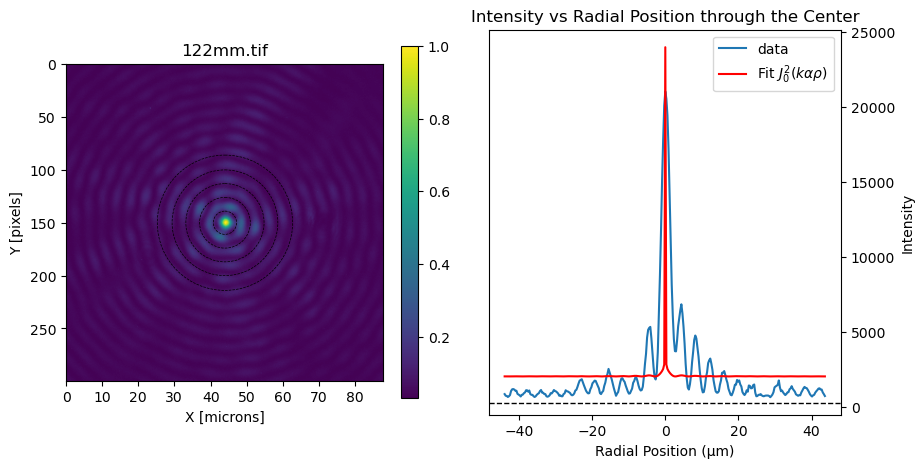

Annulus_1
Annulus_2
Annulus_3
Annulus_4


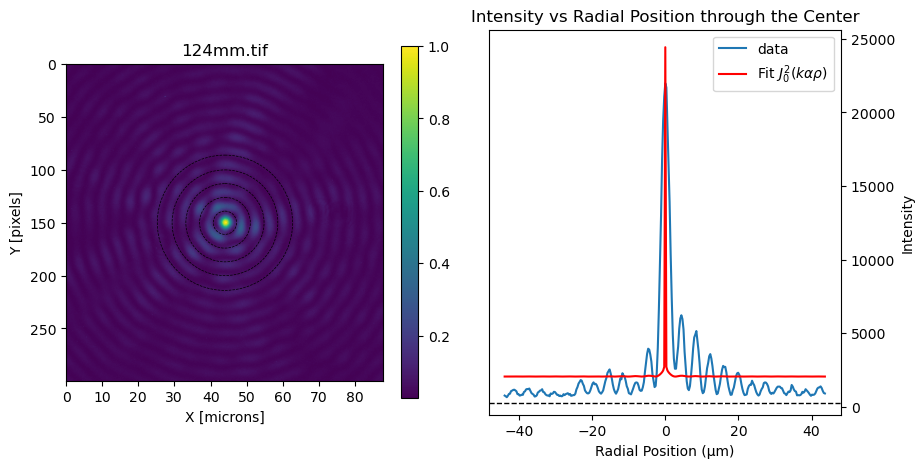

Annulus_1
Annulus_2
Annulus_3
Annulus_4


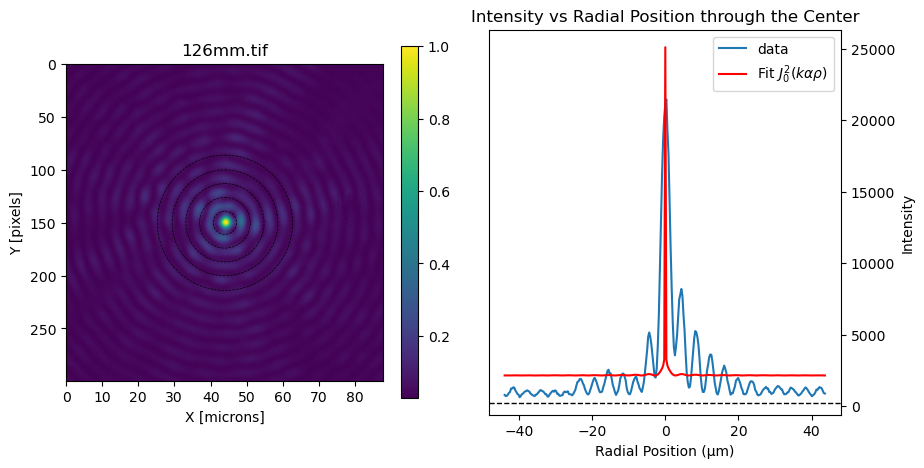

Annulus_1
Annulus_2
Annulus_3
Annulus_4


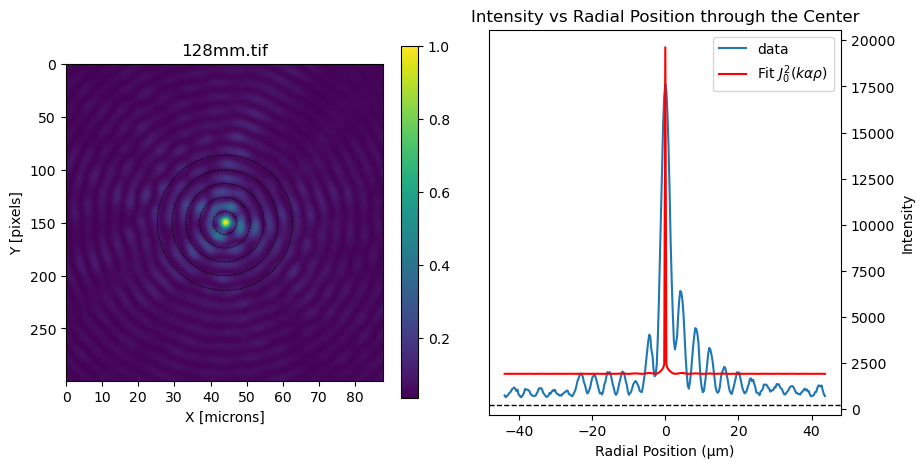

Annulus_1
Annulus_2
Annulus_3
Annulus_4


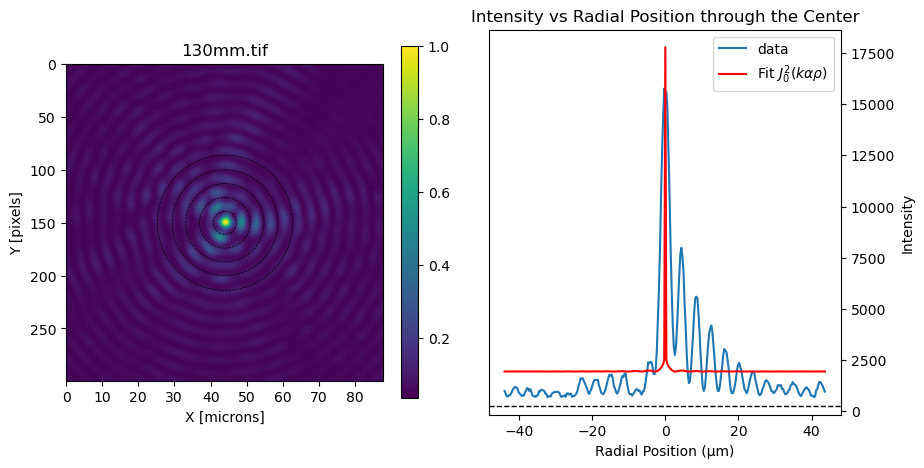

Annulus_1
Annulus_2
Annulus_3
Annulus_4


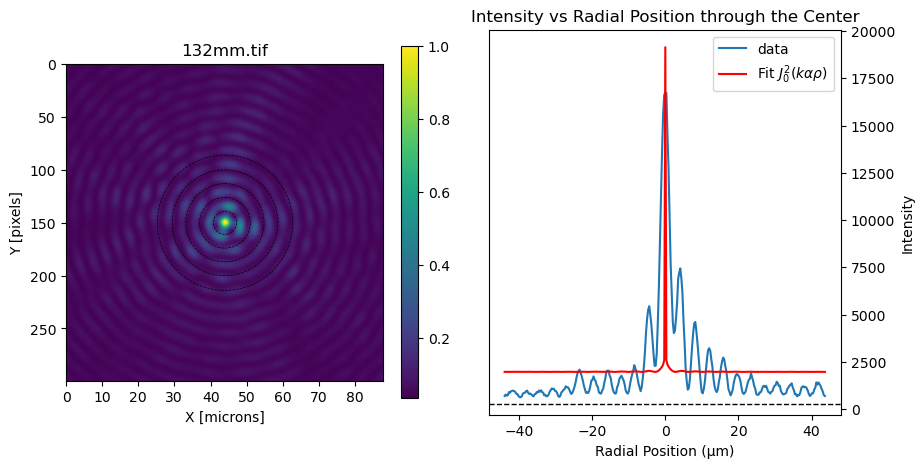

Annulus_1
Annulus_2
Annulus_3
Annulus_4


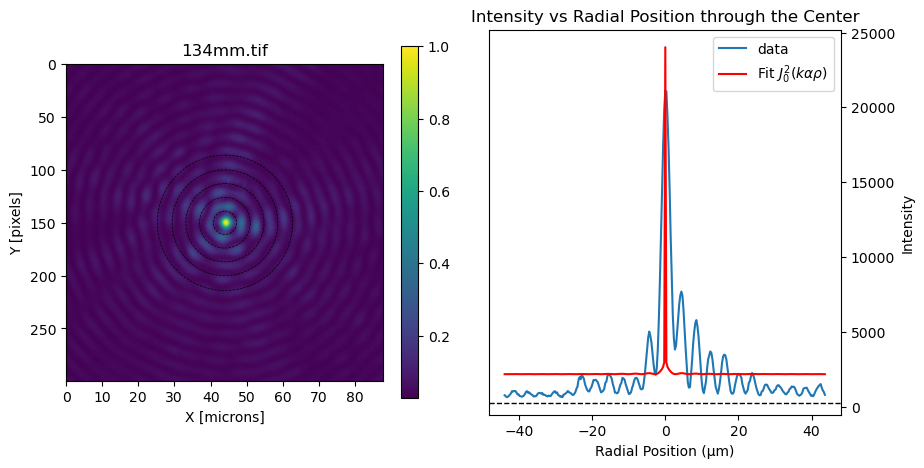

Annulus_1
Annulus_2
Annulus_3
Annulus_4


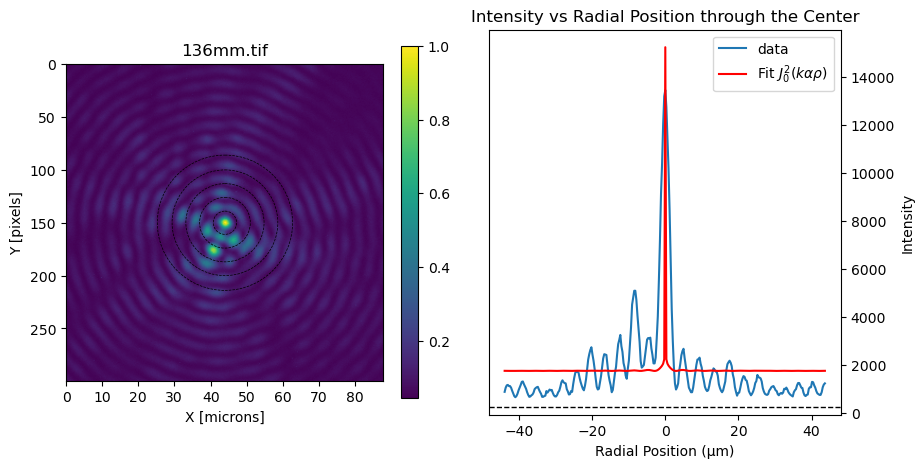

Annulus_1
Annulus_2
Annulus_3
Annulus_4
Error: Optimal parameters not found: Number of calls to function has reached maxfev = 1800.


TypeError: cannot unpack non-iterable NoneType object

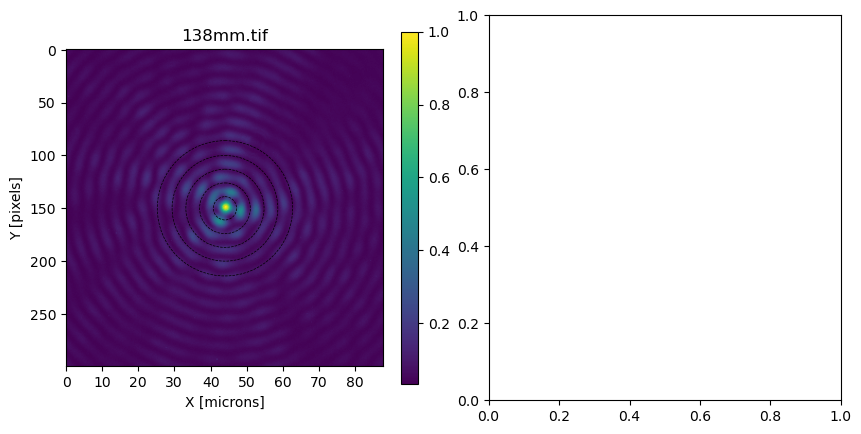

In [5]:
# Replace 'path_to_your_folder' with the actual path to your folder containing TIFF files
axi7degnoplug_folder_path = "/Volumes/LACIE/OXFORD/CALA_March_2024/PFS_laptop/240315axiscans/7degnoplug"

# Set the radius for the main circular region and the radii for additional circles
axi7degnoplug_circle_radius = 150
axi7degnoplug_circle_radii = [11, 24, 37, 50, 64]

# Get extracted numbers and results for all TIFF images in the folder
axi7degnoplug_mm, axi7degnoplug_results = show_tiff_images_with_sum_and_numbers(axi7degnoplug_folder_path, axi7degnoplug_circle_radius, axi7degnoplug_circle_radii)

/var/folders/0_/nrrxny_x54j3w76q939n8pth0000gn/T/ipykernel_2038/4240365136.py:149: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(tiff_file)


Annulus_1
Annulus_2
Annulus_3
Annulus_4


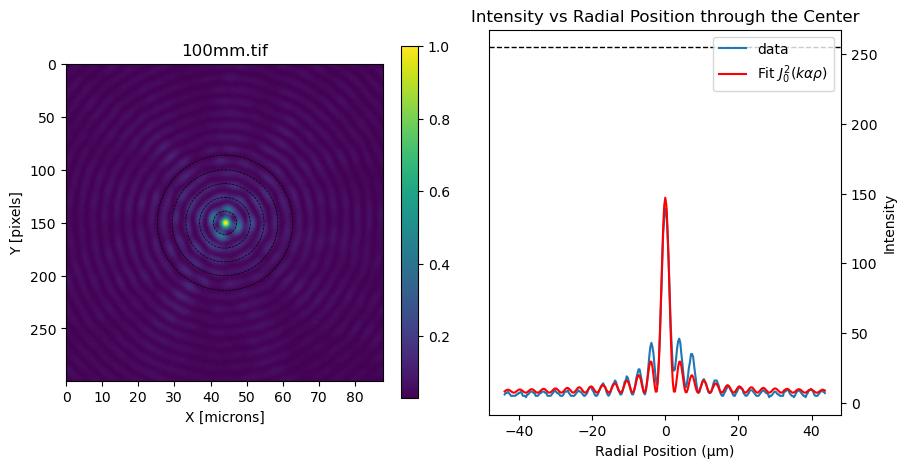

Annulus_1
Annulus_2
Annulus_3
Annulus_4


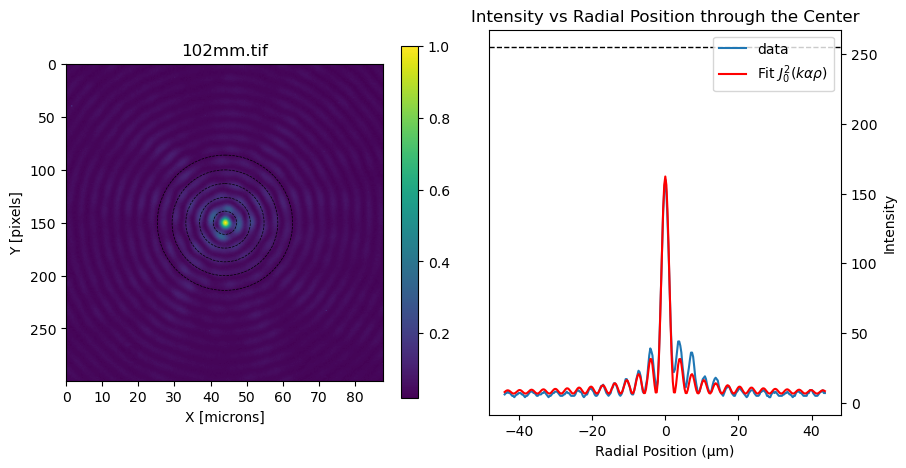

Annulus_1
Annulus_2
Annulus_3
Annulus_4


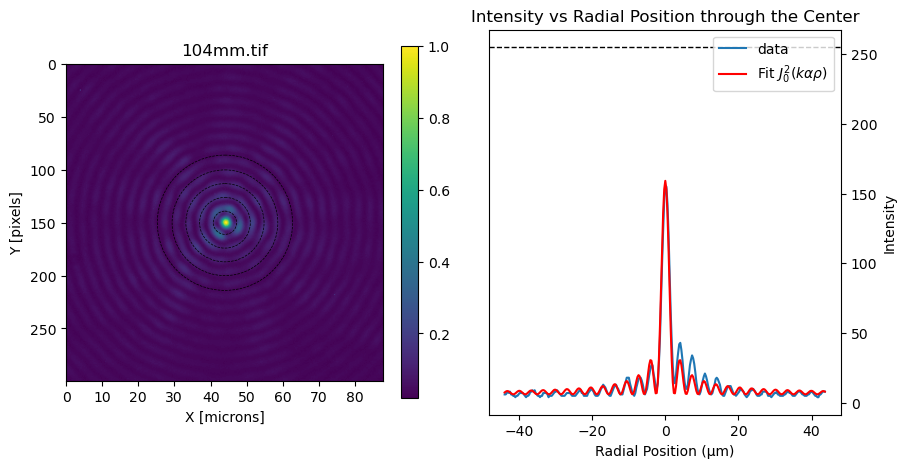

Annulus_1
Annulus_2
Annulus_3
Annulus_4


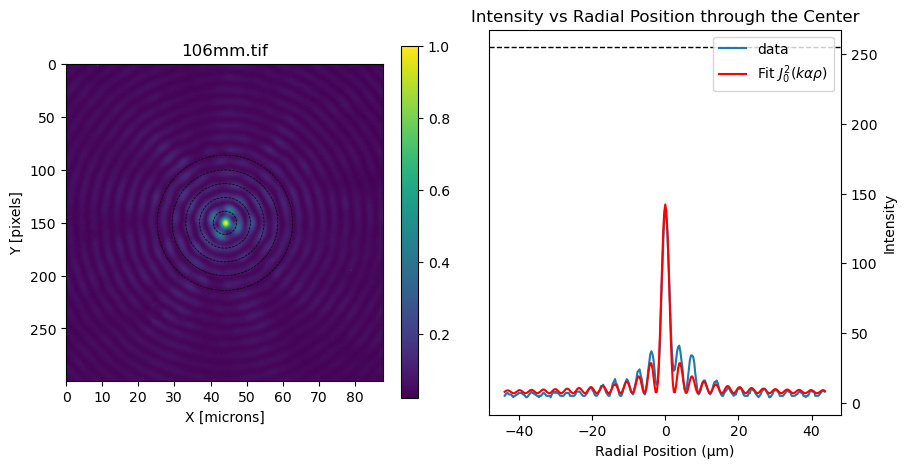

Annulus_1
Annulus_2
Annulus_3
Annulus_4


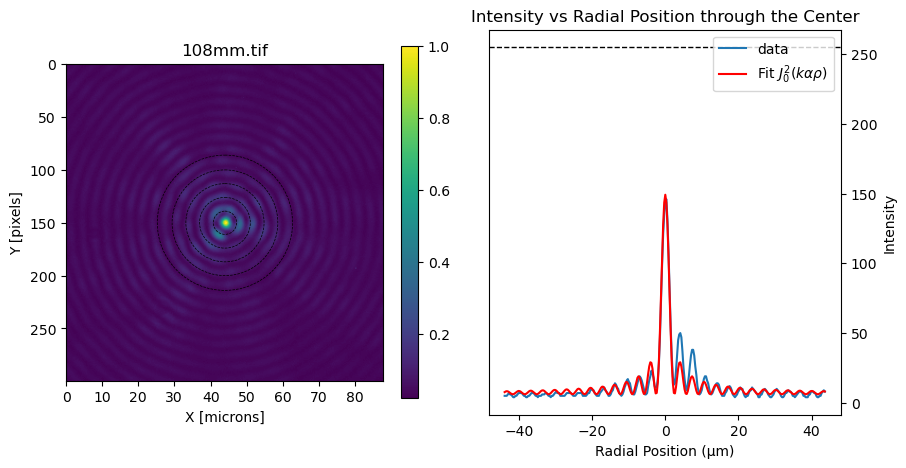

Annulus_1
Annulus_2
Annulus_3
Annulus_4


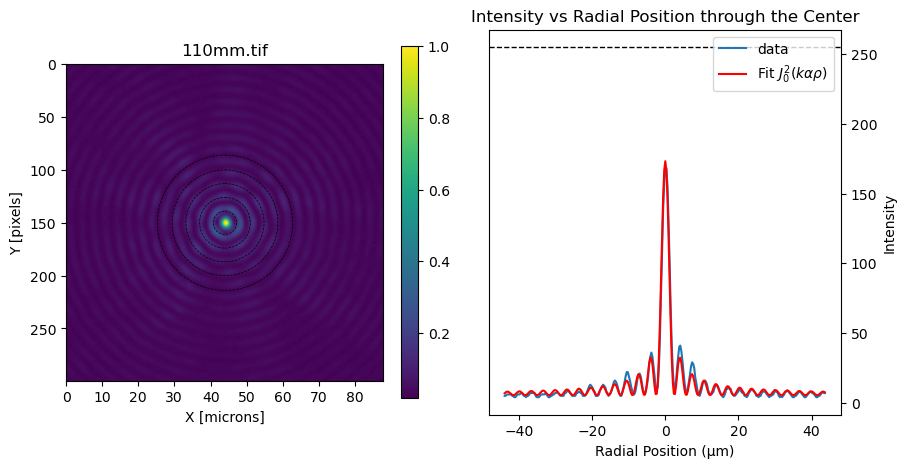

Annulus_1
Annulus_2
Annulus_3
Annulus_4


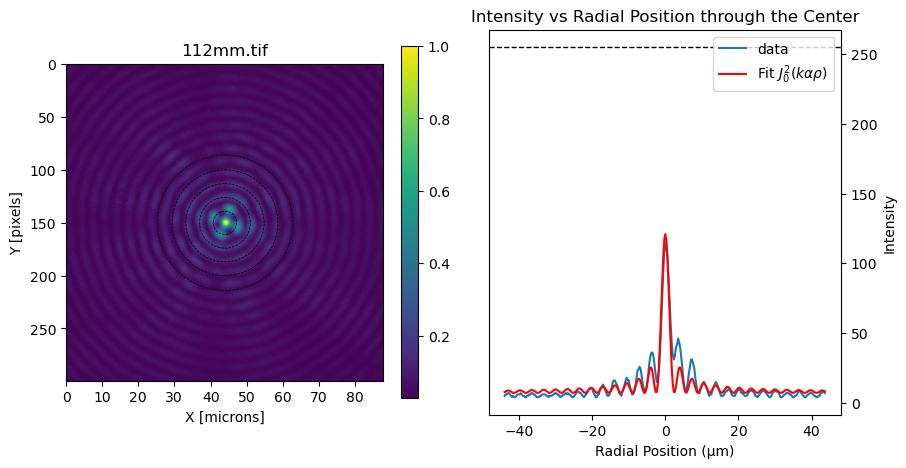

Annulus_1
Annulus_2
Annulus_3
Annulus_4


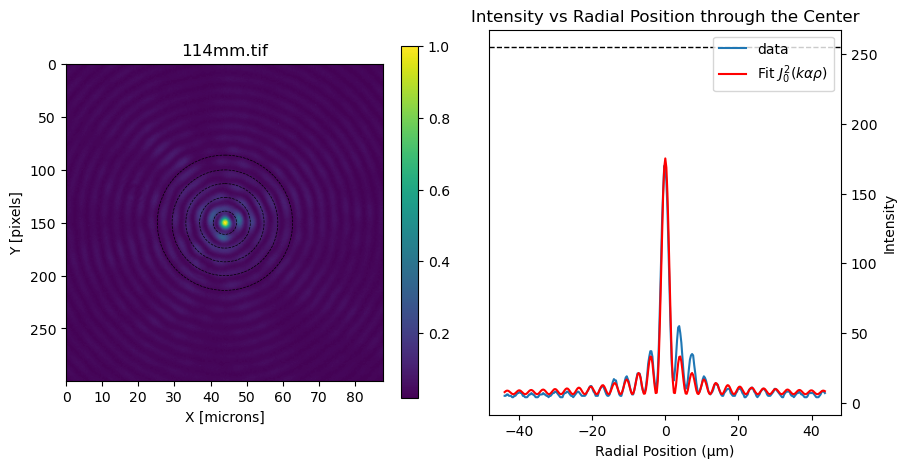

Annulus_1
Annulus_2
Annulus_3
Annulus_4


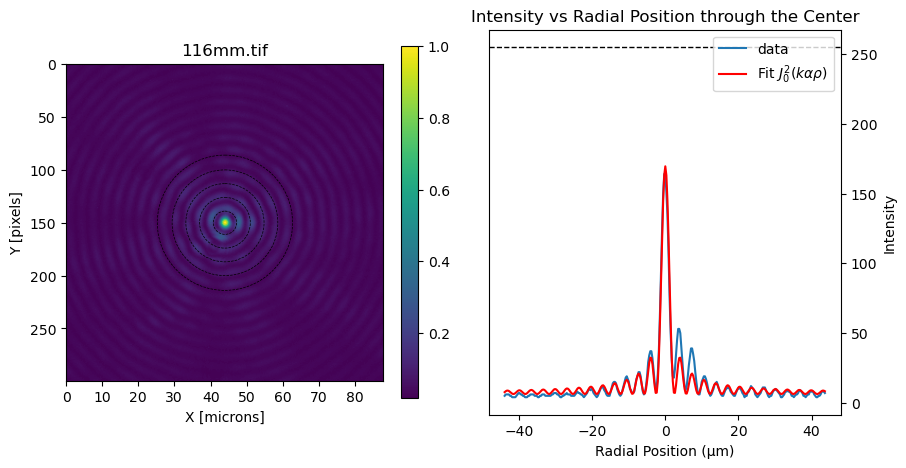

Annulus_1
Annulus_2
Annulus_3
Annulus_4


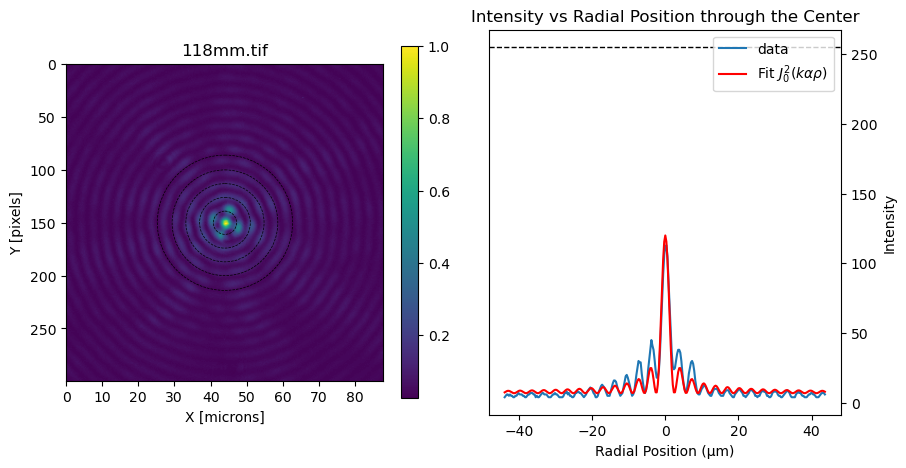

Annulus_1
Annulus_2
Annulus_3
Annulus_4


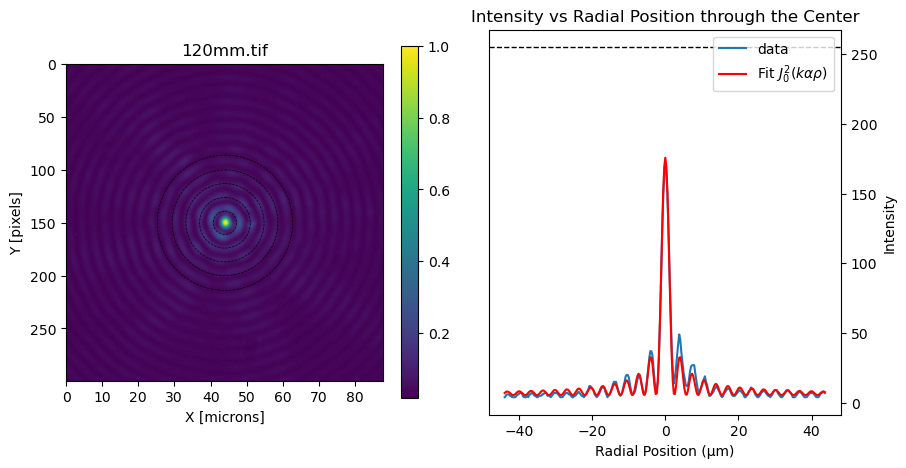

Annulus_1
Annulus_2
Annulus_3
Annulus_4


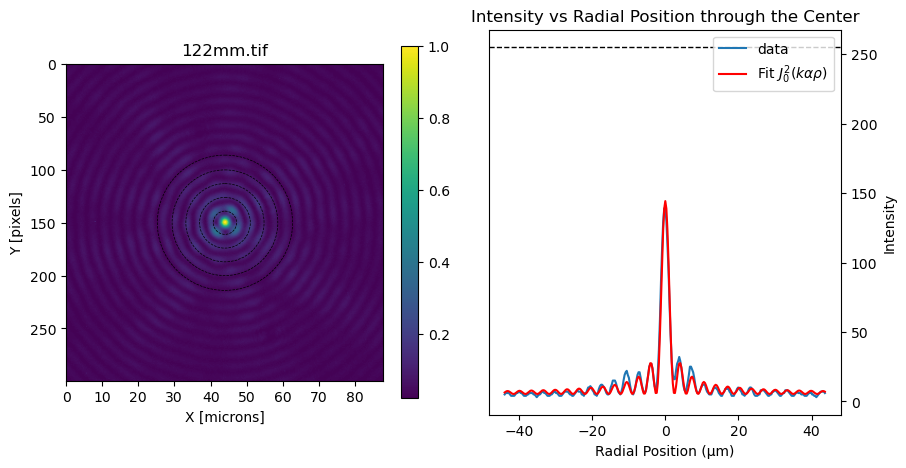

Annulus_1
Annulus_2
Annulus_3
Annulus_4


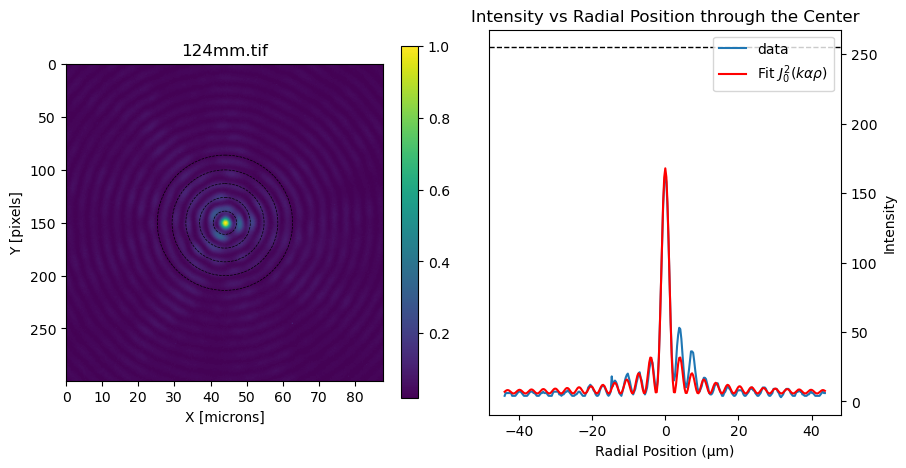

Annulus_1
Annulus_2
Annulus_3
Annulus_4


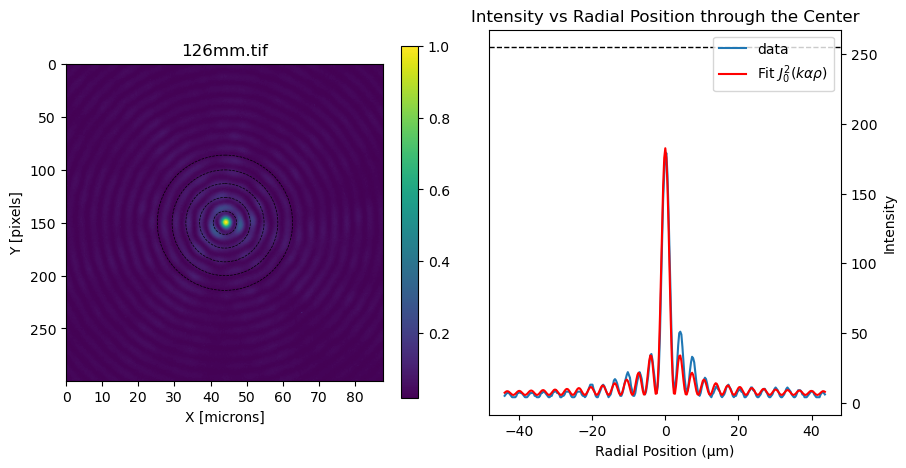

Annulus_1
Annulus_2
Annulus_3
Annulus_4


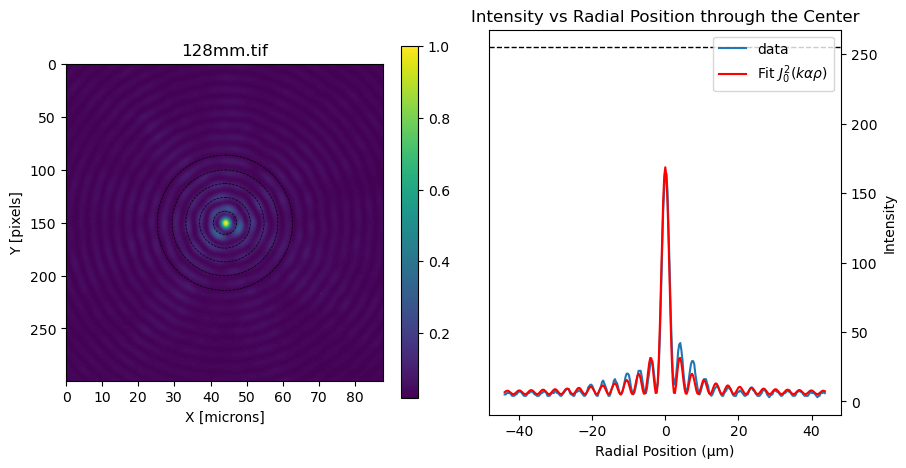

Annulus_1
Annulus_2
Annulus_3
Annulus_4


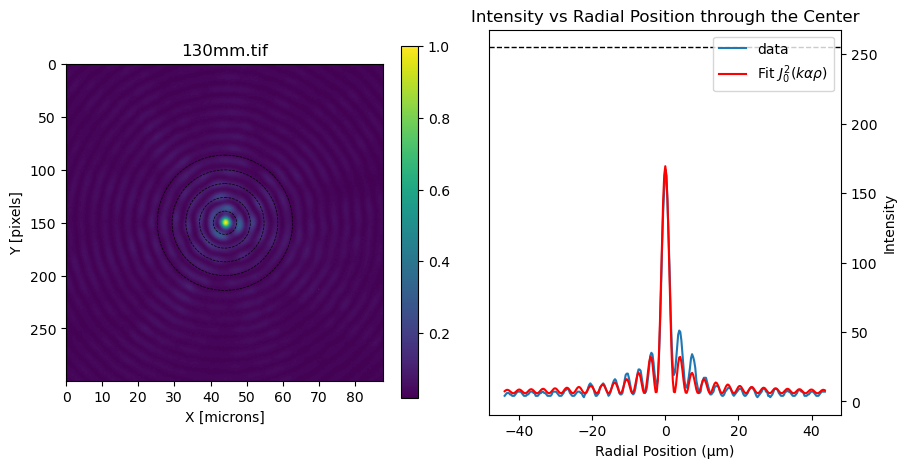

Annulus_1
Annulus_2
Annulus_3
Annulus_4


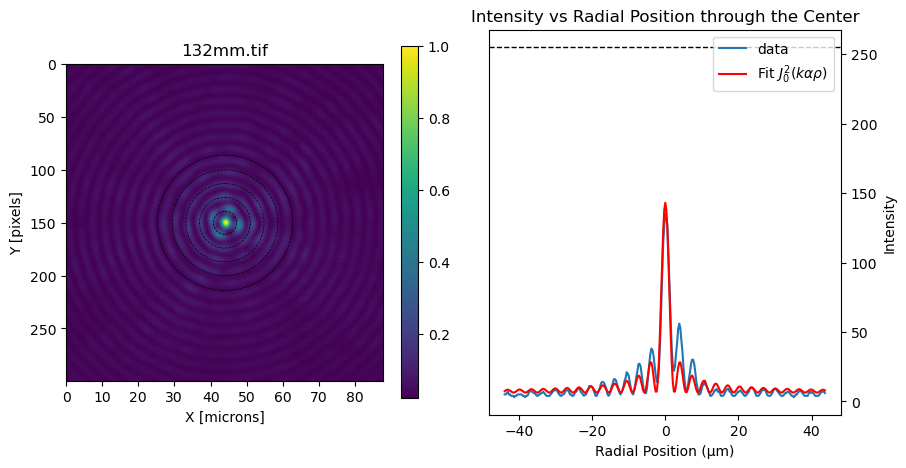

Annulus_1
Annulus_2
Annulus_3
Annulus_4


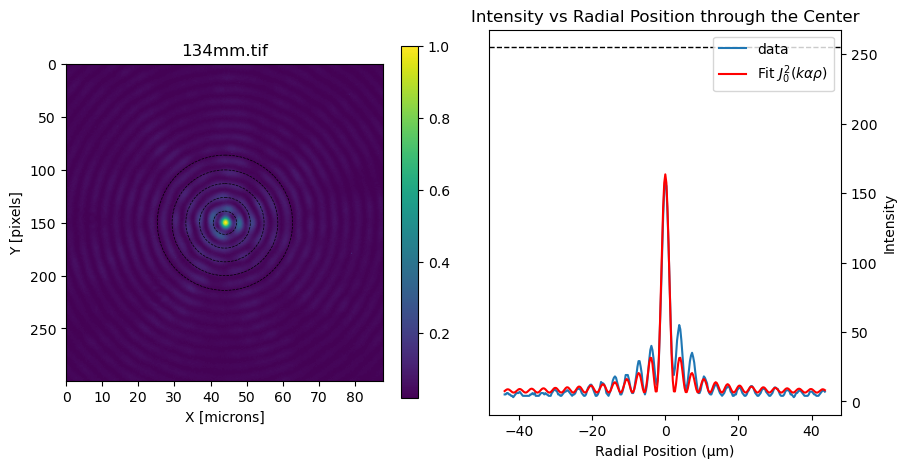

Annulus_1
Annulus_2
Annulus_3
Annulus_4


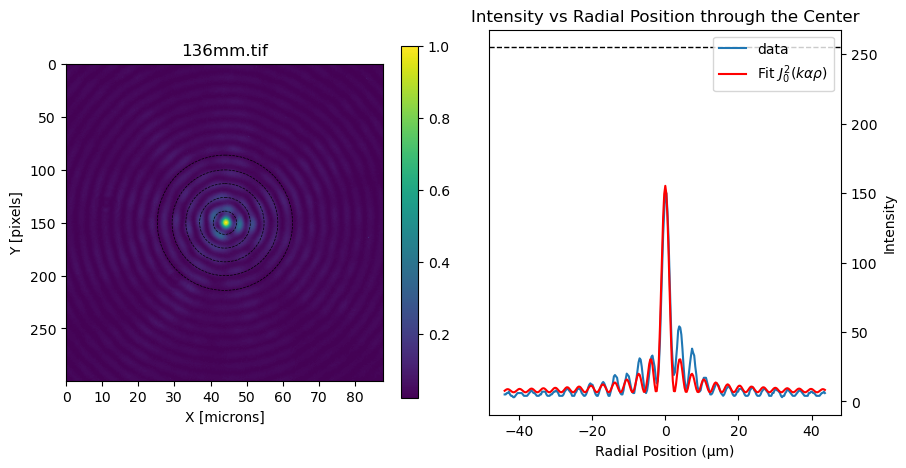

Annulus_1
Annulus_2
Annulus_3
Annulus_4


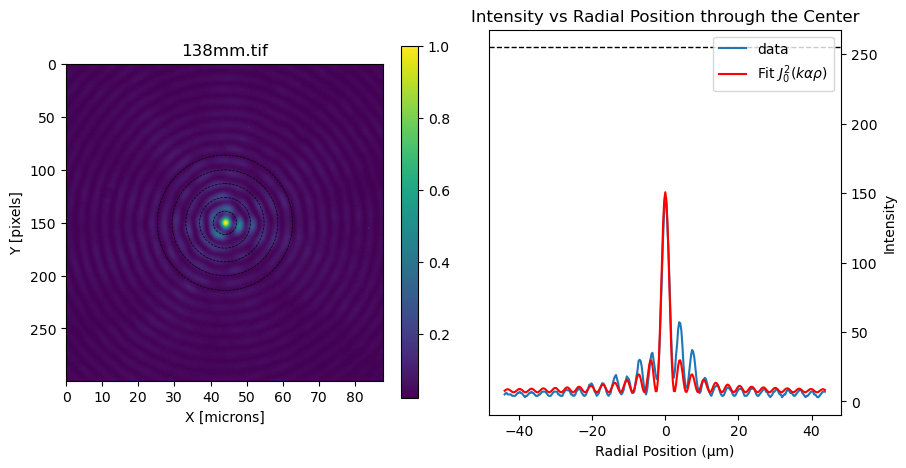

Annulus_1
Annulus_2
Annulus_3
Annulus_4


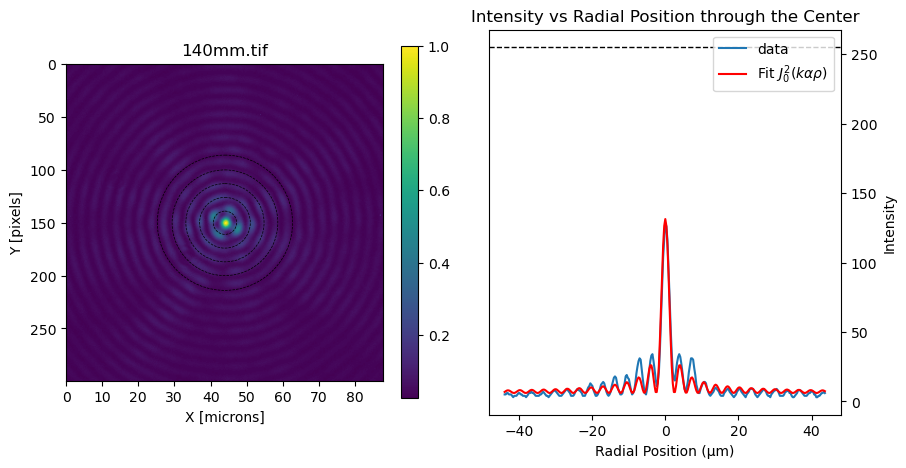

Annulus_1
Annulus_2
Annulus_3
Annulus_4


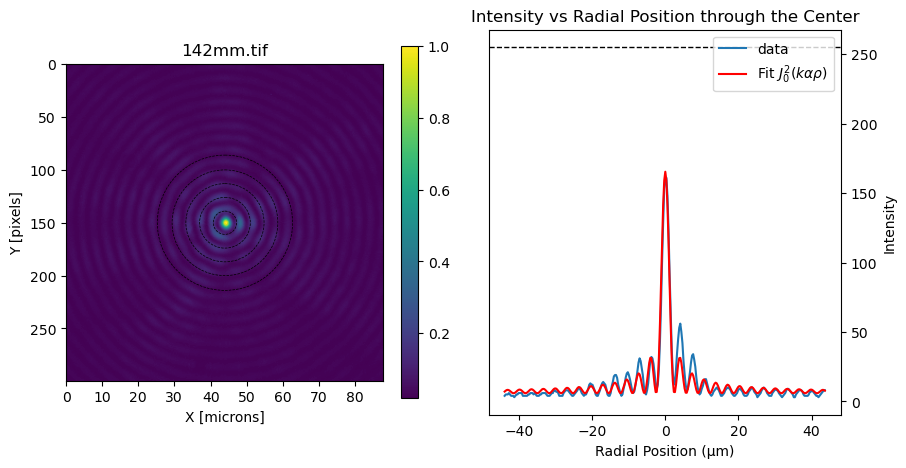

Annulus_1
Annulus_2
Annulus_3
Annulus_4


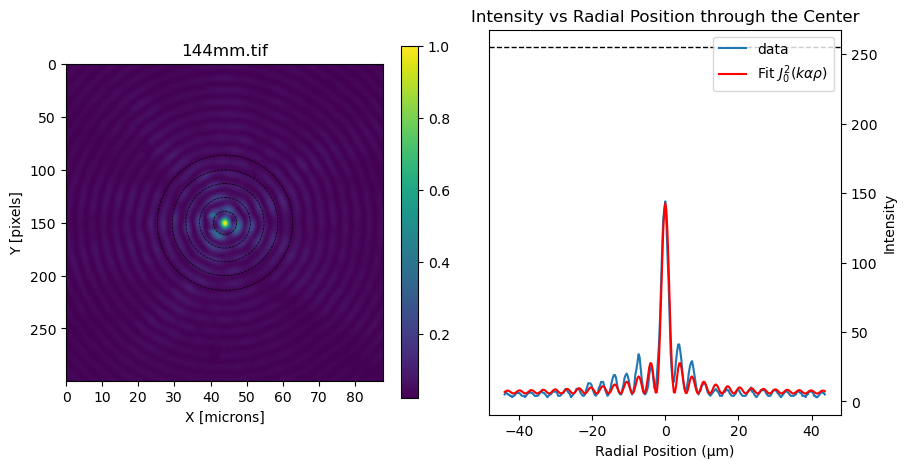

Annulus_1
Annulus_2
Annulus_3
Annulus_4


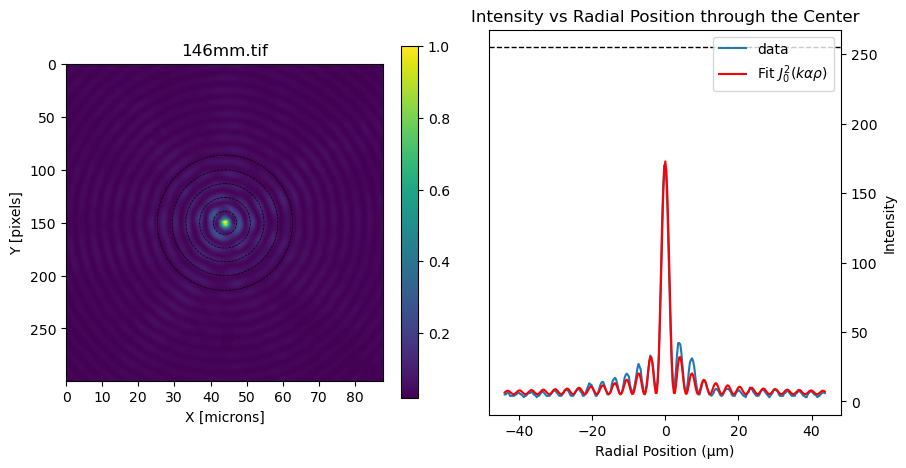

Annulus_1
Annulus_2
Annulus_3
Annulus_4


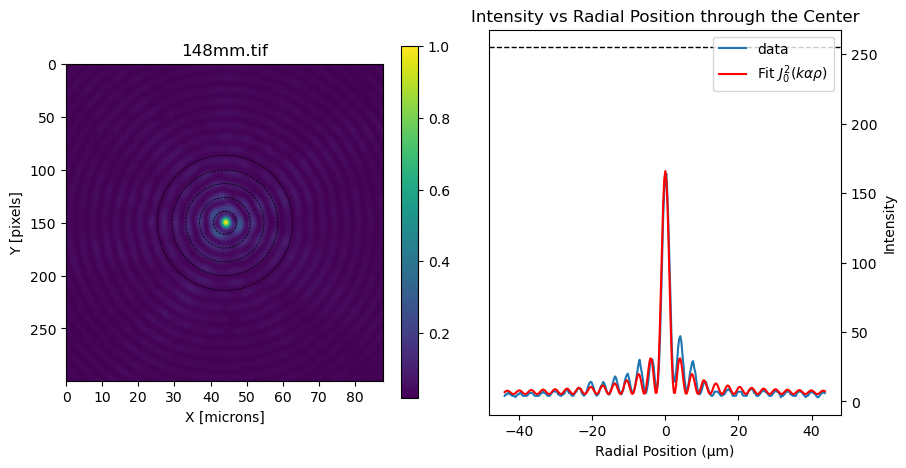

Annulus_1
Annulus_2
Annulus_3
Annulus_4


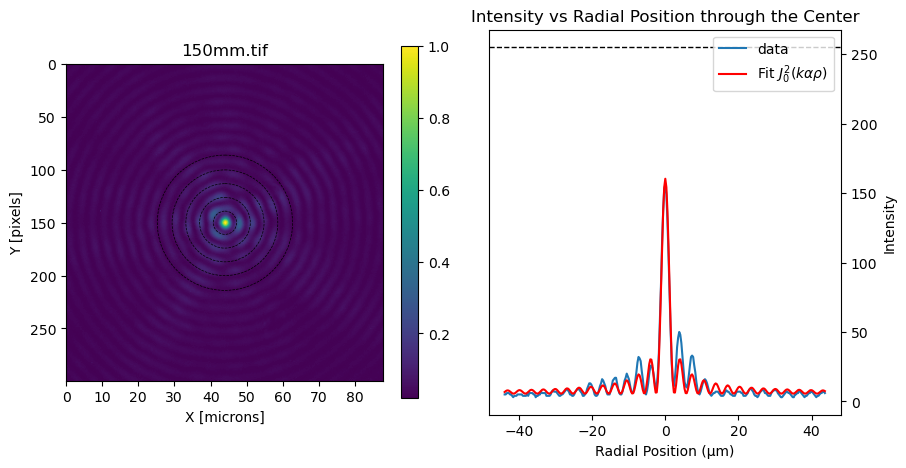

Annulus_1
Annulus_2
Annulus_3
Annulus_4


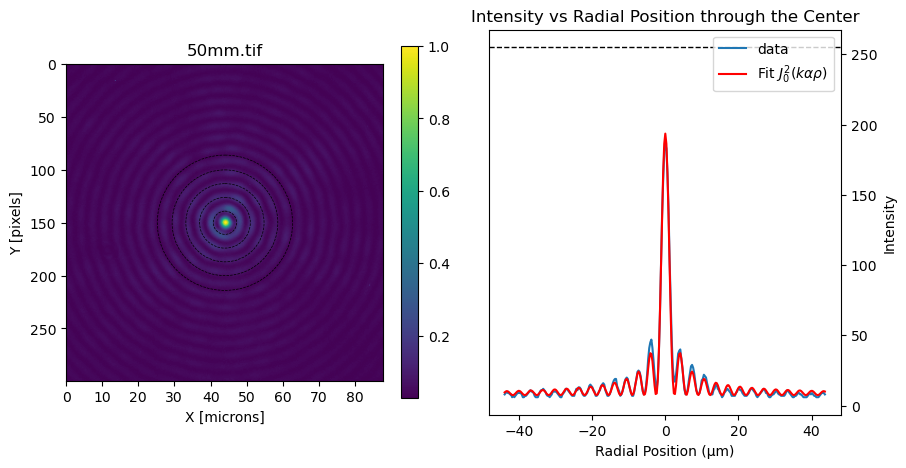

Annulus_1
Annulus_2
Annulus_3
Annulus_4


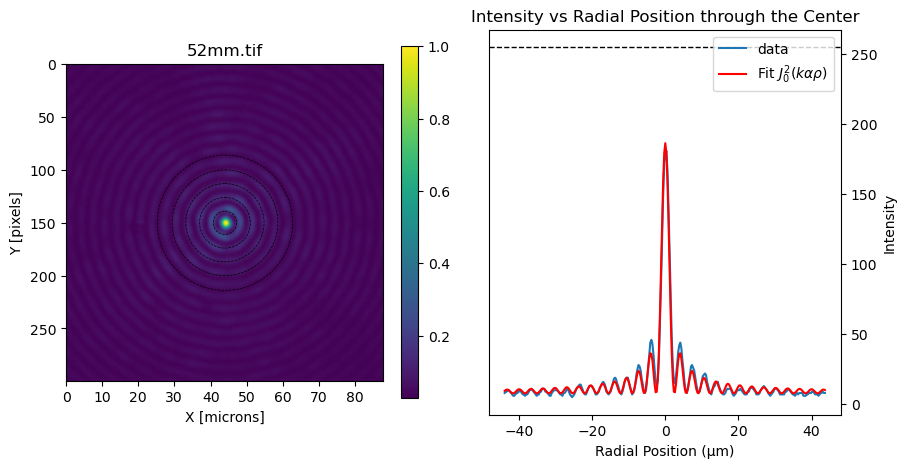

Annulus_1
Annulus_2
Annulus_3
Annulus_4


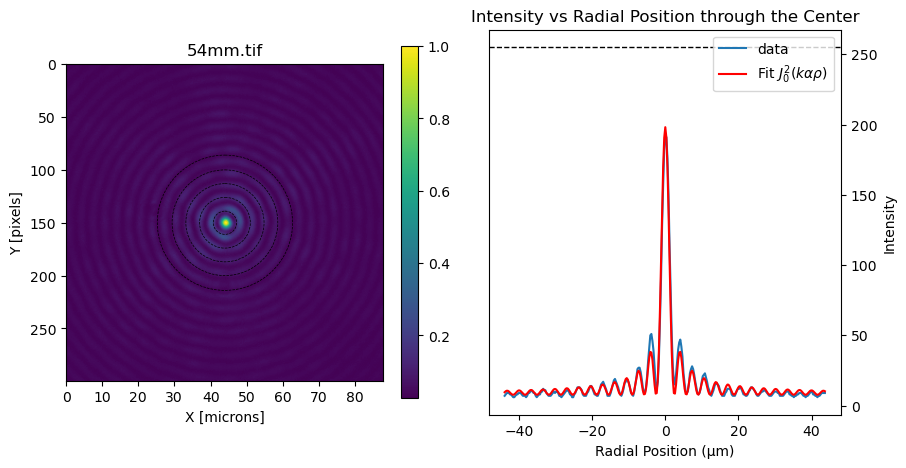

Annulus_1
Annulus_2
Annulus_3
Annulus_4


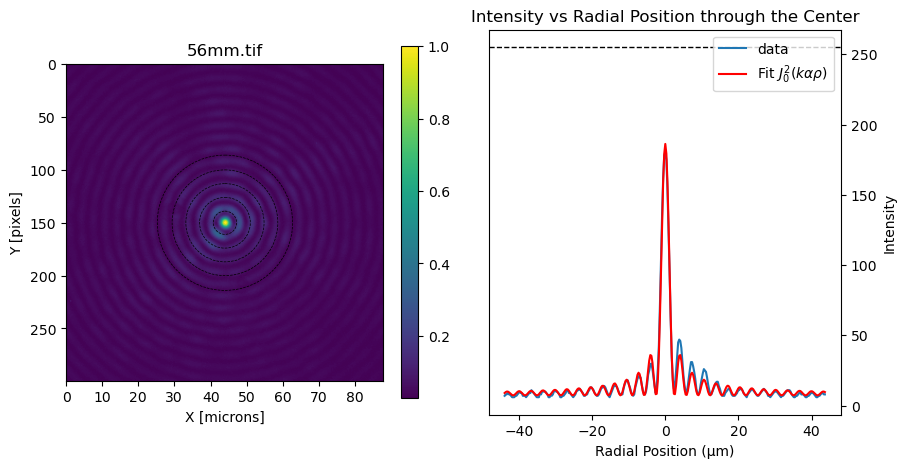

Annulus_1
Annulus_2
Annulus_3
Annulus_4


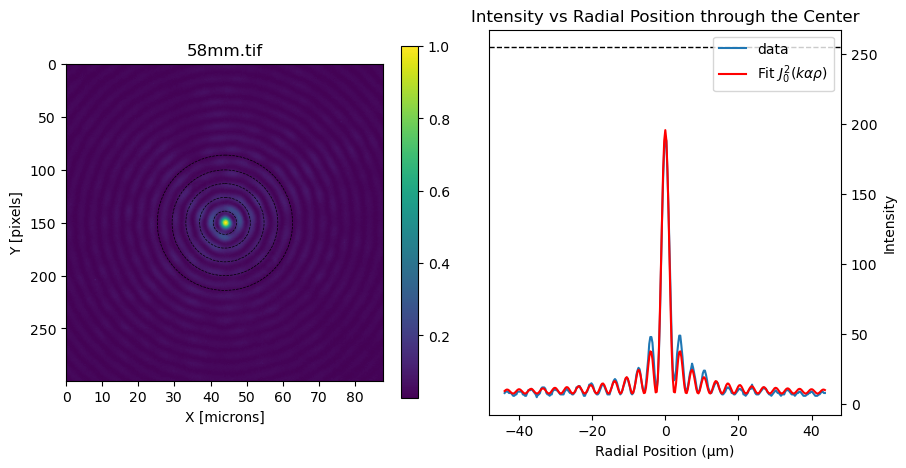

Annulus_1
Annulus_2
Annulus_3
Annulus_4


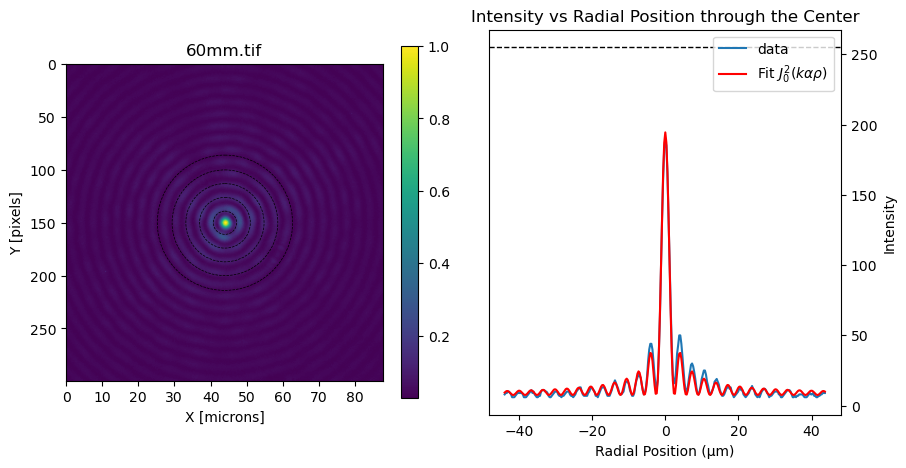

Annulus_1
Annulus_2
Annulus_3
Annulus_4


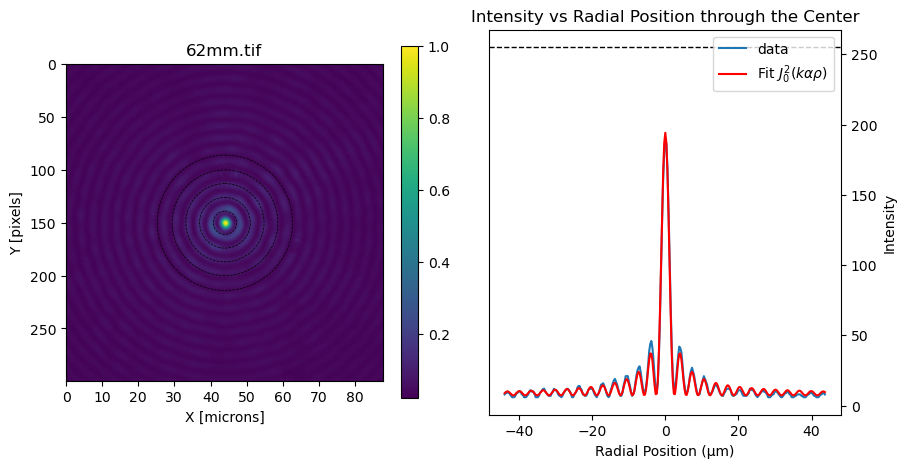

Annulus_1
Annulus_2
Annulus_3
Annulus_4


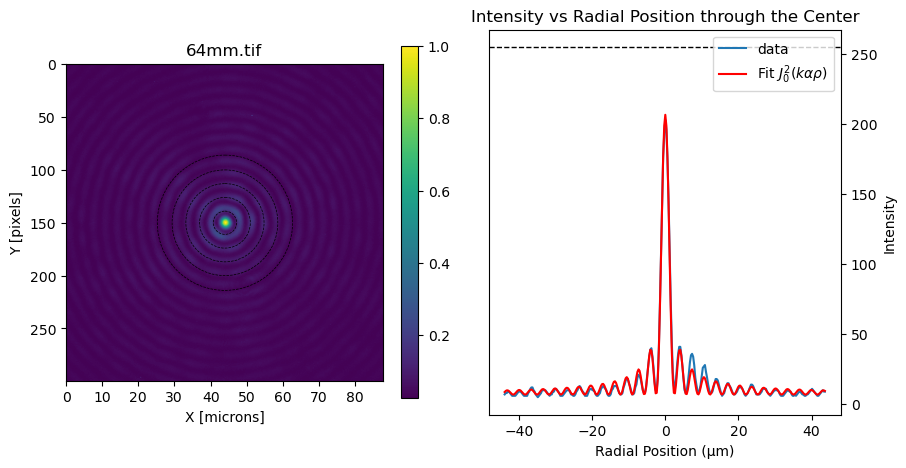

Annulus_1
Annulus_2
Annulus_3
Annulus_4


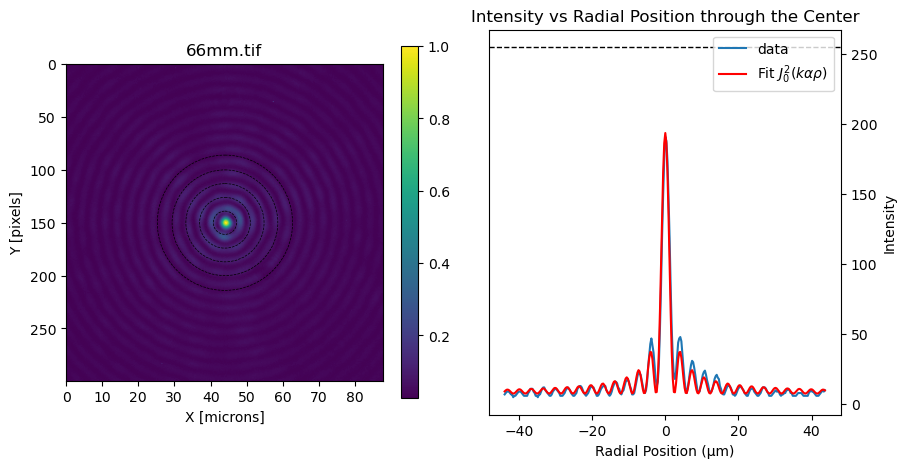

Annulus_1
Annulus_2
Annulus_3
Annulus_4


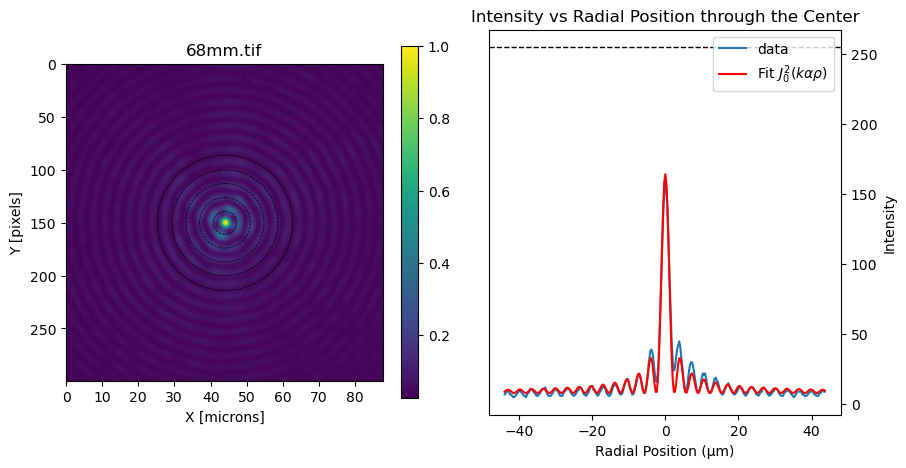

Annulus_1
Annulus_2
Annulus_3
Annulus_4


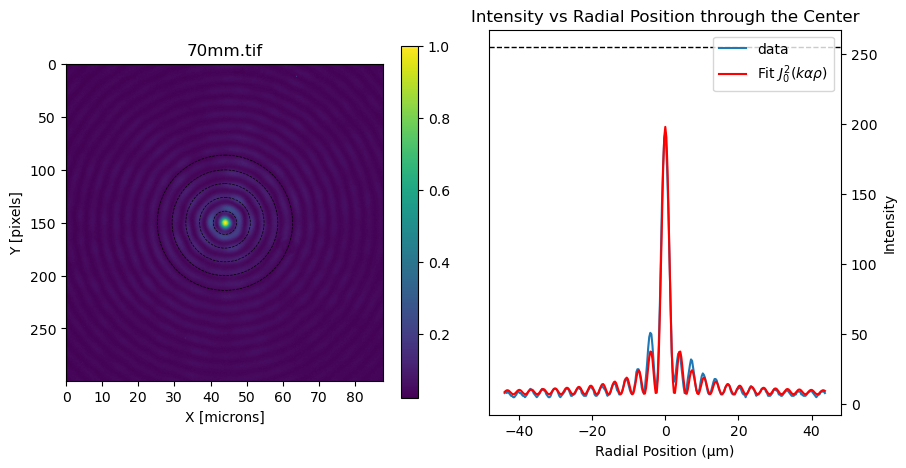

Annulus_1
Annulus_2
Annulus_3
Annulus_4


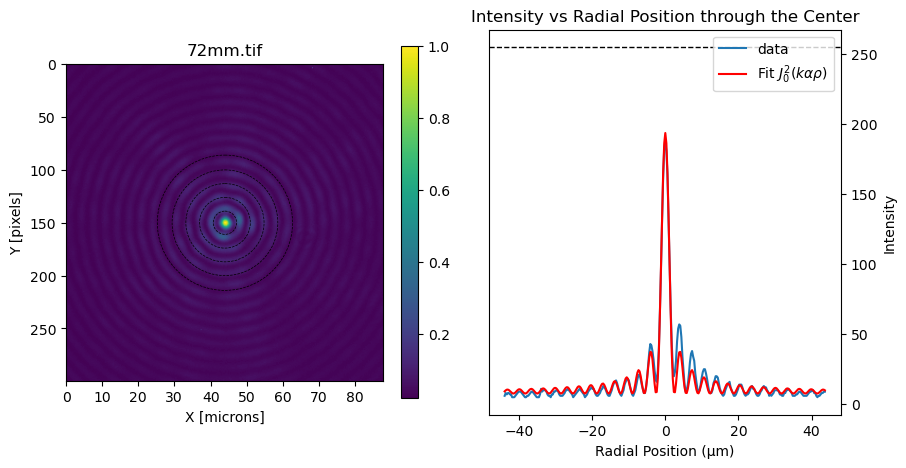

Annulus_1
Annulus_2
Annulus_3
Annulus_4


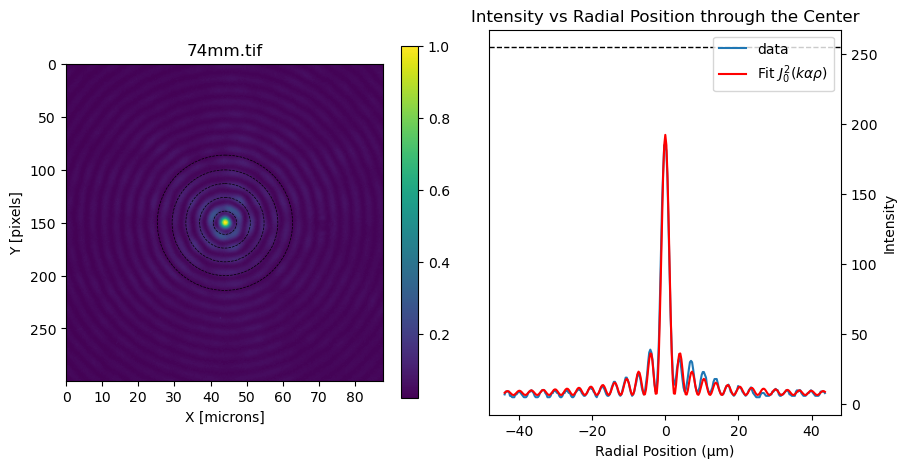

Annulus_1
Annulus_2
Annulus_3
Annulus_4


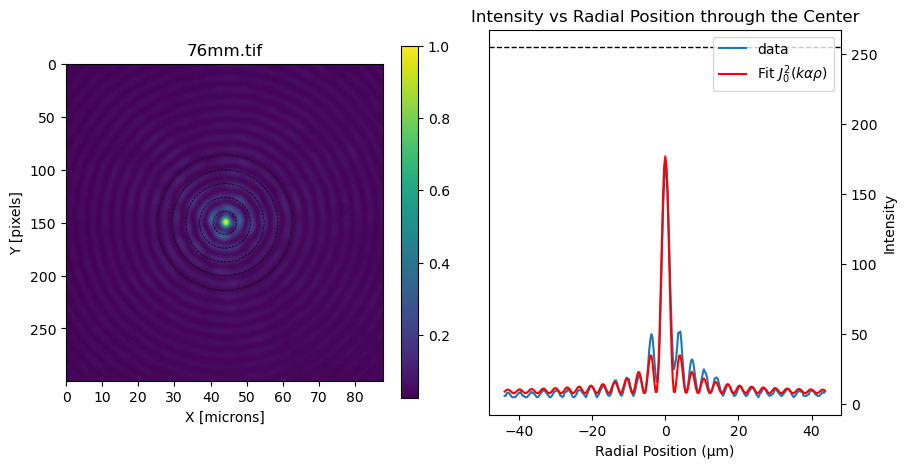

Annulus_1
Annulus_2
Annulus_3
Annulus_4


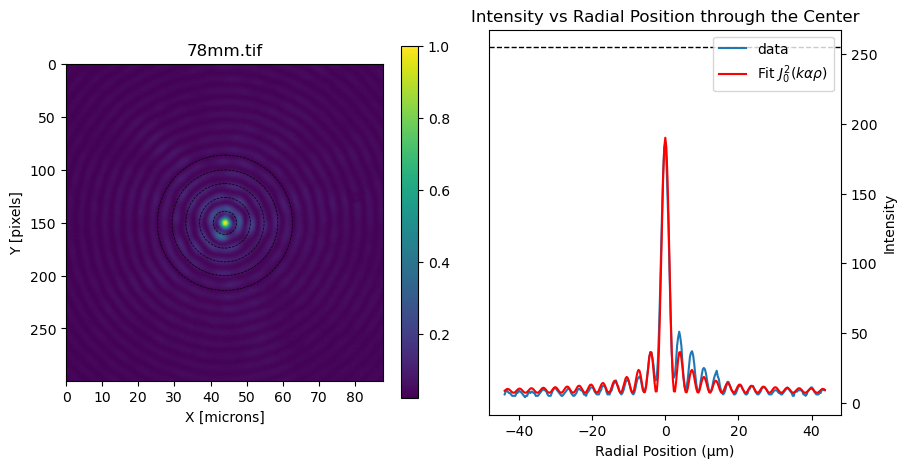

Annulus_1
Annulus_2
Annulus_3
Annulus_4


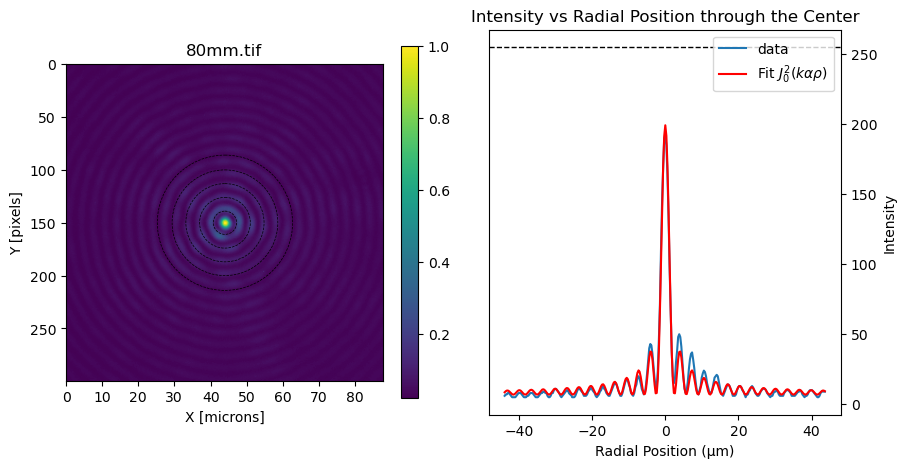

Annulus_1
Annulus_2
Annulus_3
Annulus_4


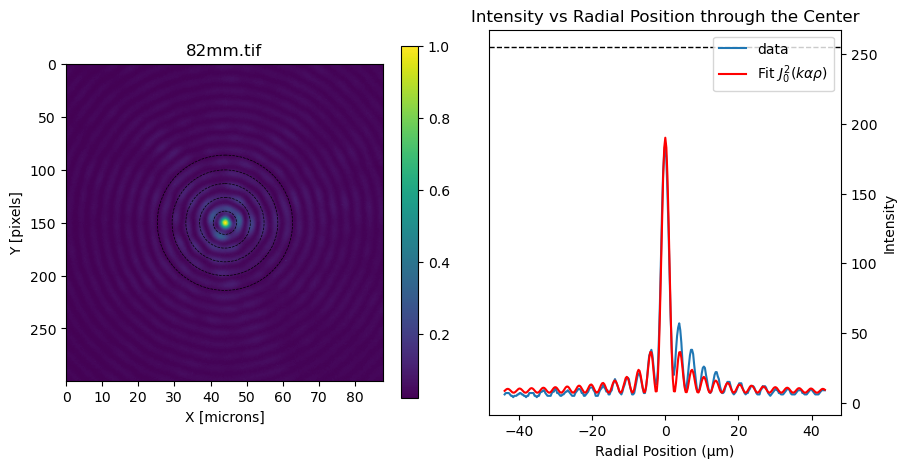

Annulus_1
Annulus_2
Annulus_3
Annulus_4


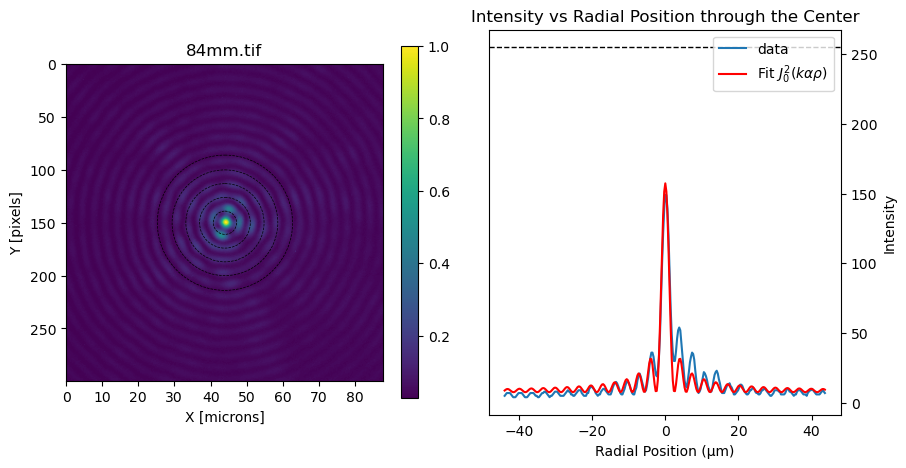

Annulus_1
Annulus_2
Annulus_3
Annulus_4


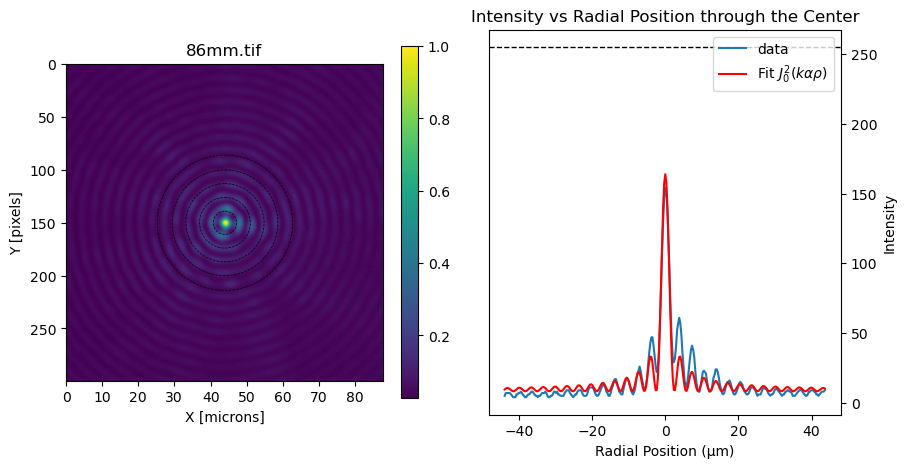

Annulus_1
Annulus_2
Annulus_3
Annulus_4


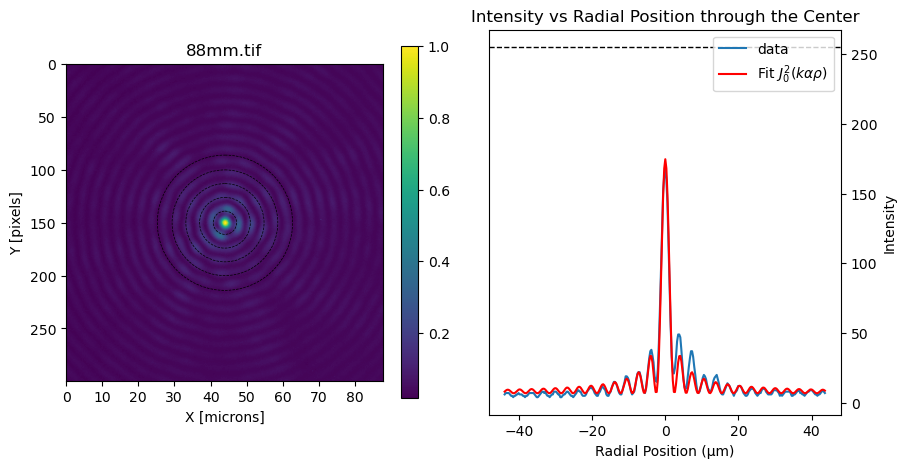

Annulus_1
Annulus_2
Annulus_3
Annulus_4


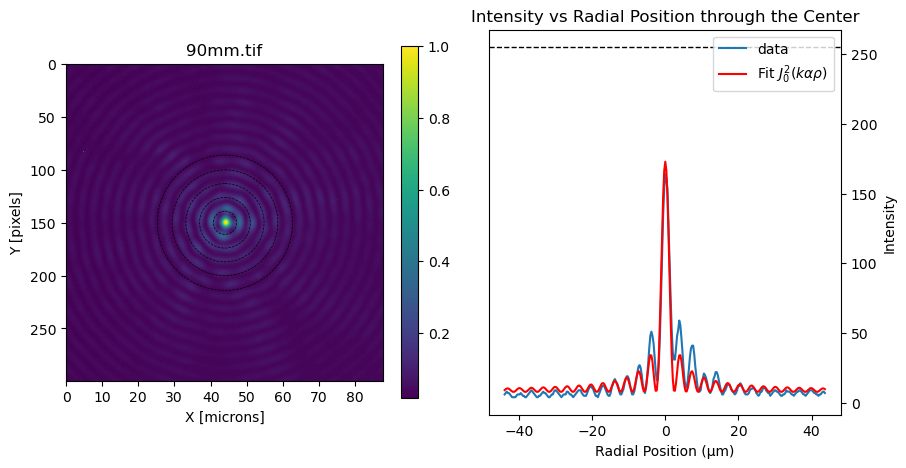

Annulus_1
Annulus_2
Annulus_3
Annulus_4


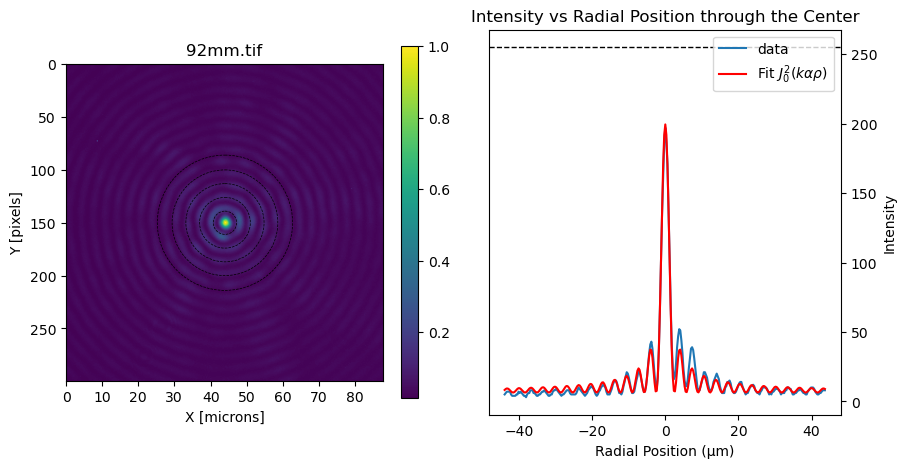

Annulus_1
Annulus_2
Annulus_3
Annulus_4


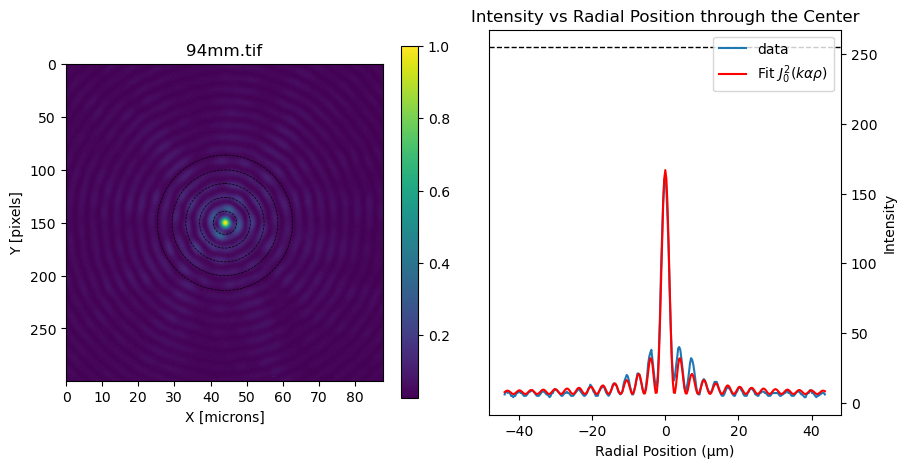

Annulus_1
Annulus_2
Annulus_3
Annulus_4


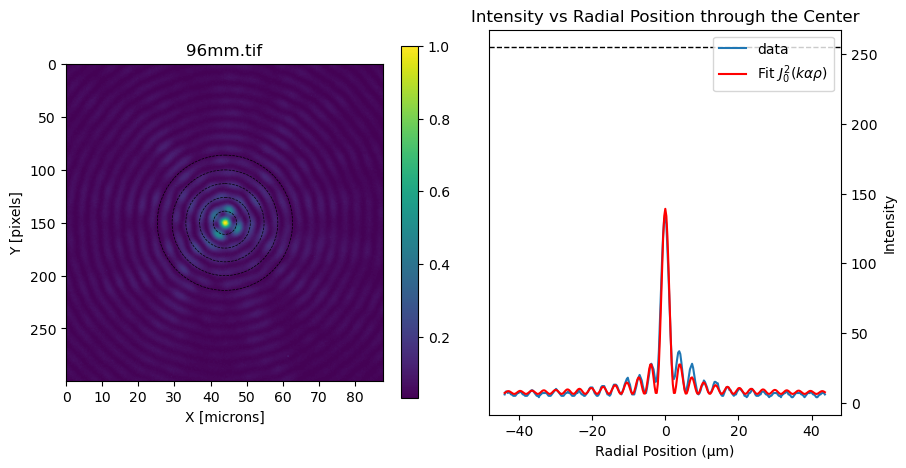

Annulus_1
Annulus_2
Annulus_3
Annulus_4


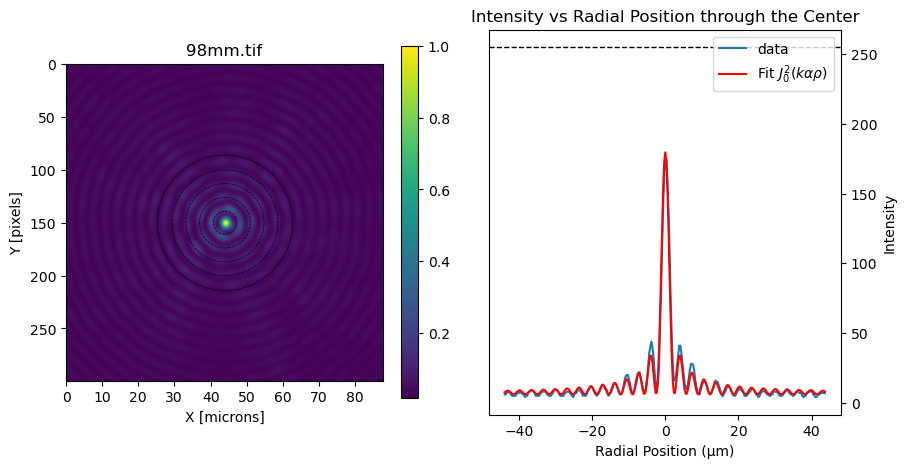

In [6]:
# Replace 'path_to_your_folder' with the actual path to your folder containing TIFF files
axi8degnoplug_folder_path = "/Volumes/LACIE/OXFORD/CALA_March_2024/PFS_laptop/240315axiscans/8degnoplug"

# Set the radius for the main circular region and the radii for additional circles
axi8degnoplug_circle_radius = 150
axi8degnoplug_circle_radii = [11, 24, 37, 50, 64]

# Get extracted numbers and results for all TIFF images in the folder
axi8degnoplug_mm, axi8degnoplug_results = show_tiff_images_with_sum_and_numbers(axi8degnoplug_folder_path, axi8degnoplug_circle_radius, axi8degnoplug_circle_radii)

/var/folders/0_/nrrxny_x54j3w76q939n8pth0000gn/T/ipykernel_2038/4240365136.py:149: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(tiff_file)


Annulus_1
Annulus_2
Annulus_3
Annulus_4


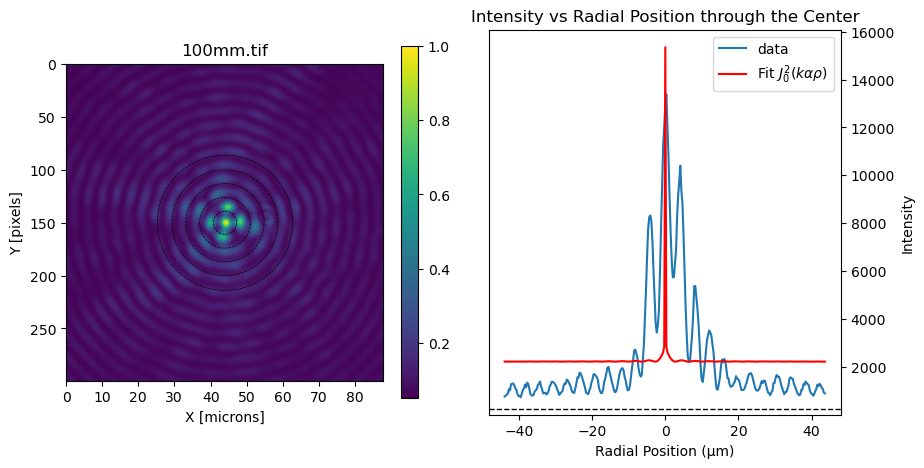

Annulus_1
Annulus_2
Annulus_3
Annulus_4


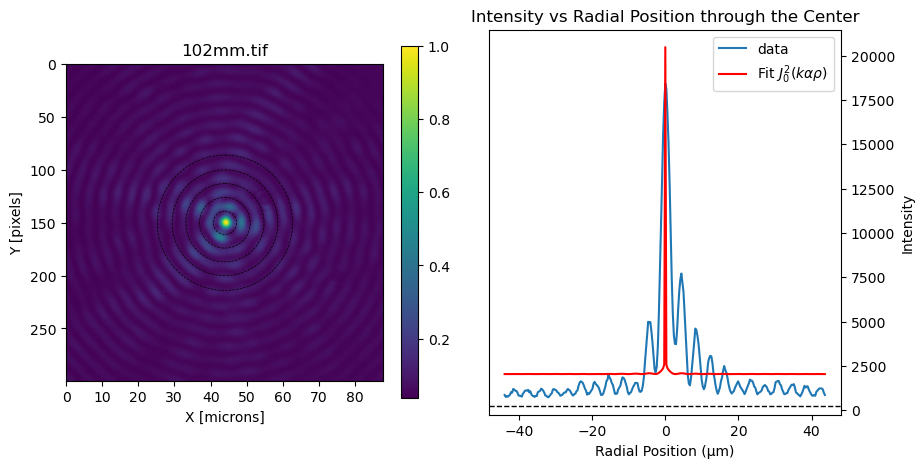

Annulus_1
Annulus_2
Annulus_3
Annulus_4


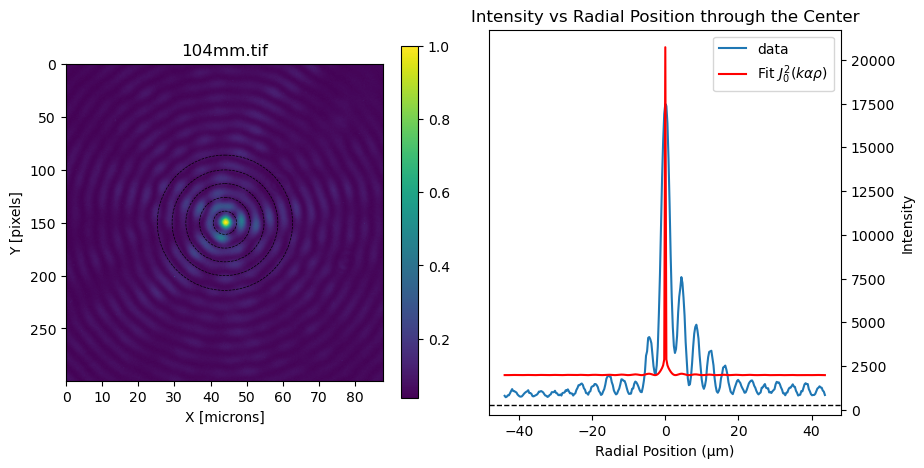

Annulus_1
Annulus_2
Annulus_3
Annulus_4


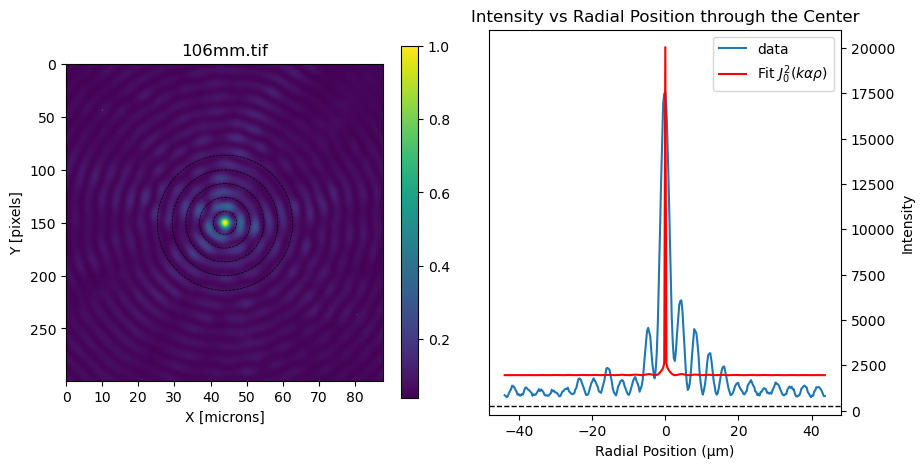

Annulus_1
Annulus_2
Annulus_3
Annulus_4


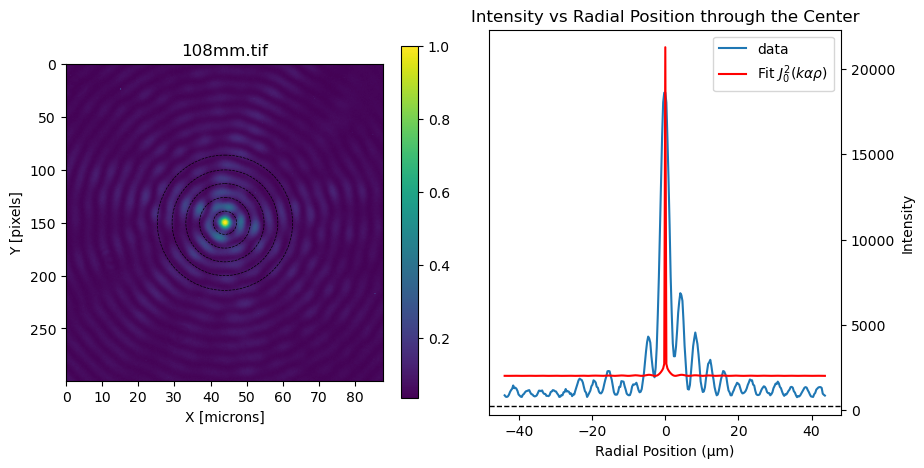

Annulus_1
Annulus_2
Annulus_3
Annulus_4


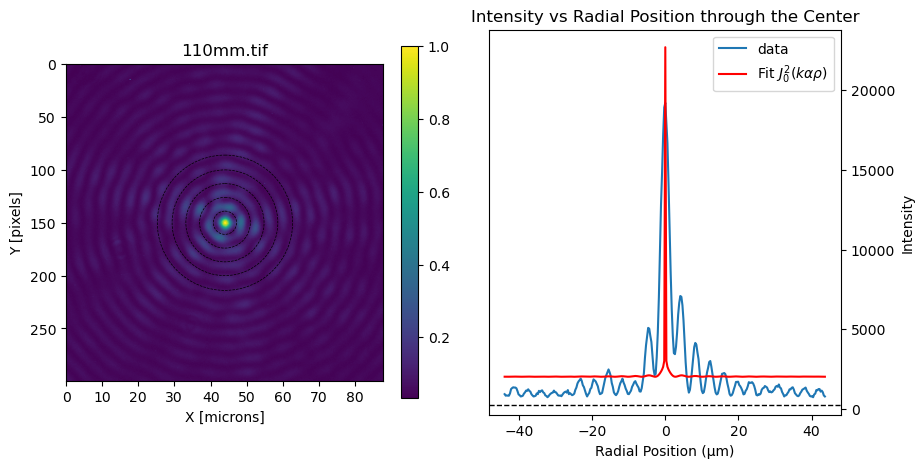

Annulus_1
Annulus_2
Annulus_3
Annulus_4


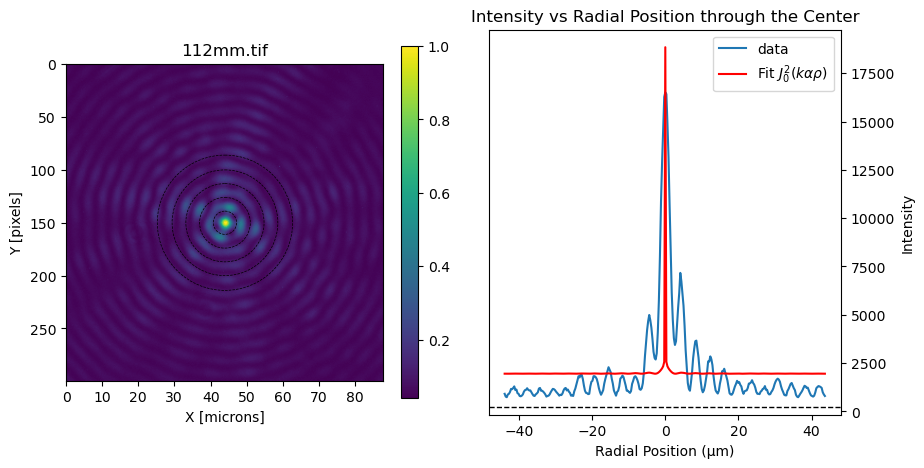

Annulus_1
Annulus_2
Annulus_3
Annulus_4


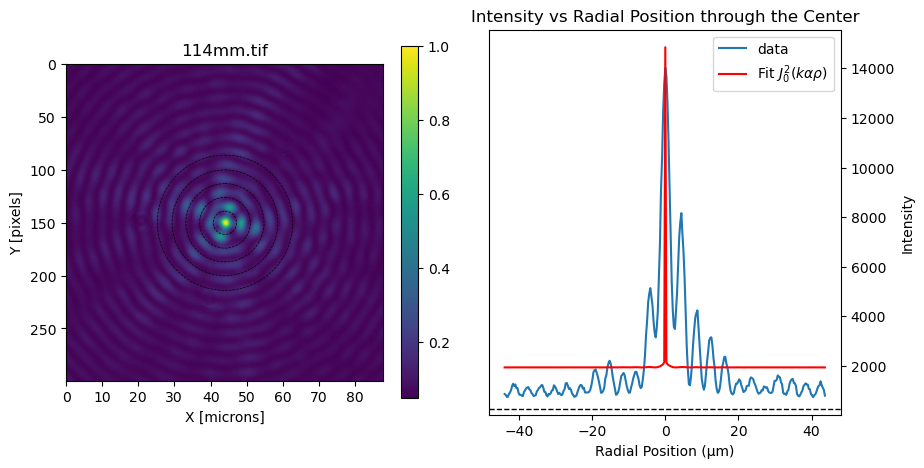

Annulus_1
Annulus_2
Annulus_3
Annulus_4


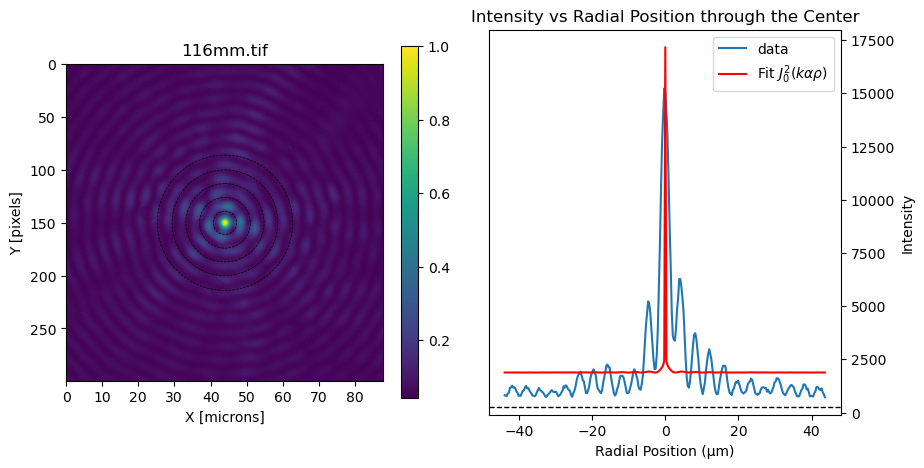

Annulus_1
Annulus_2
Annulus_3
Annulus_4


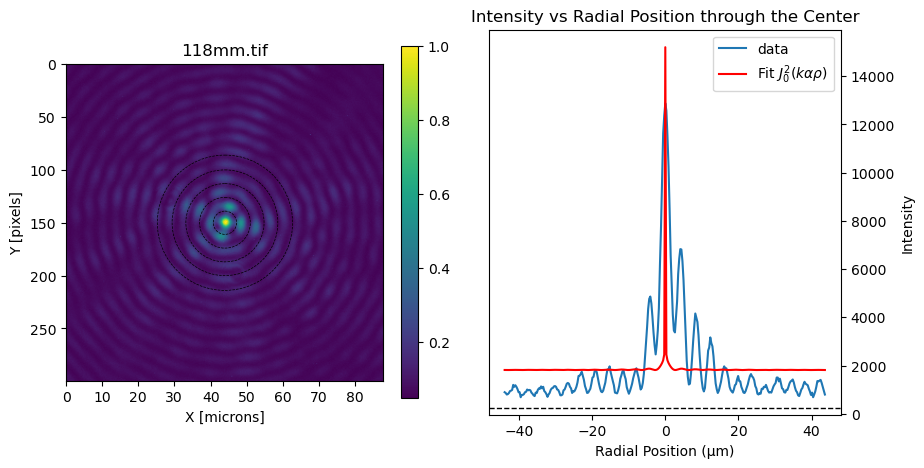

Annulus_1
Annulus_2
Annulus_3
Annulus_4


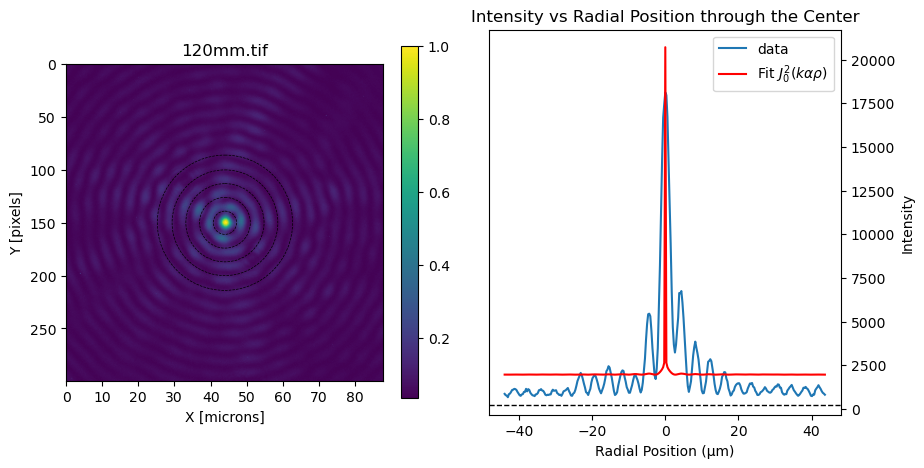

Annulus_1
Annulus_2
Annulus_3
Annulus_4


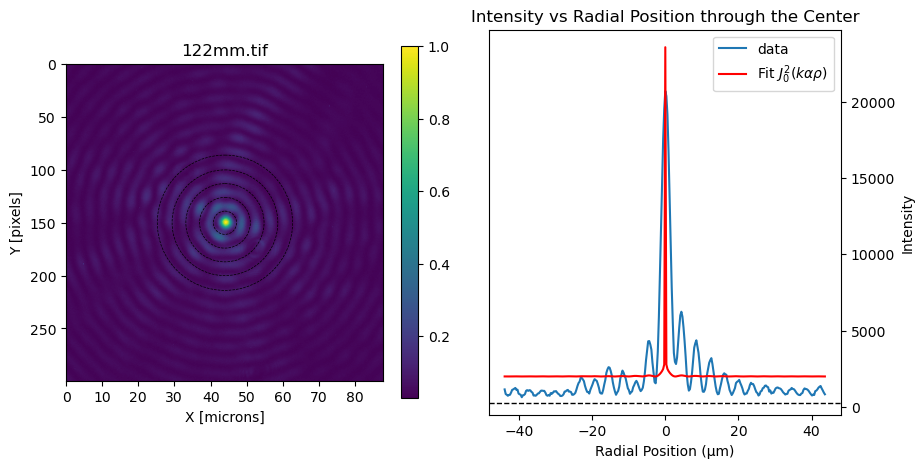

Annulus_1
Annulus_2
Annulus_3
Annulus_4


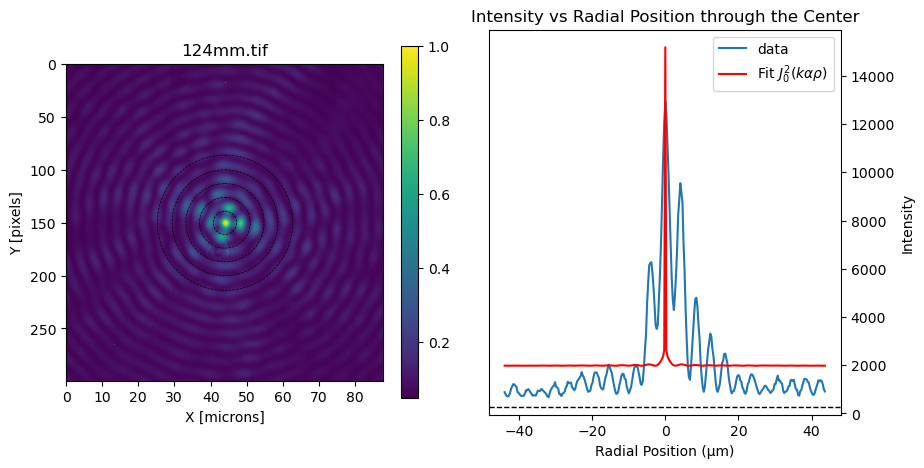

Annulus_1
Annulus_2
Annulus_3
Annulus_4


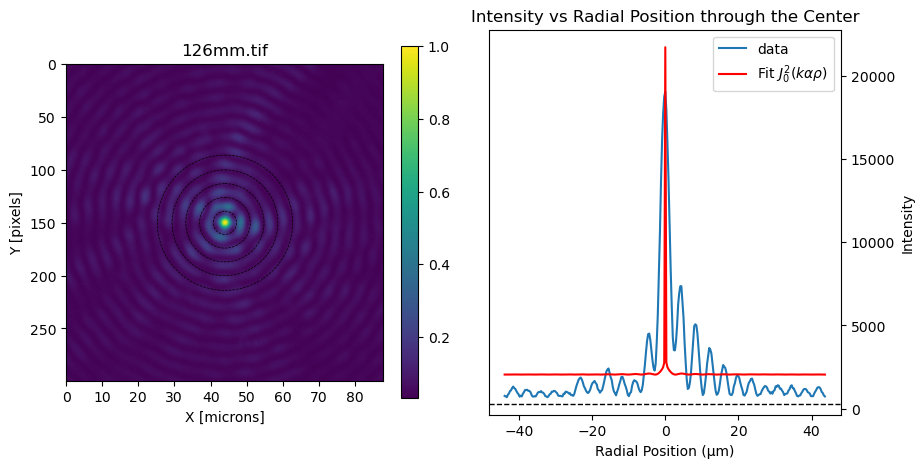

Annulus_1
Annulus_2
Annulus_3
Annulus_4


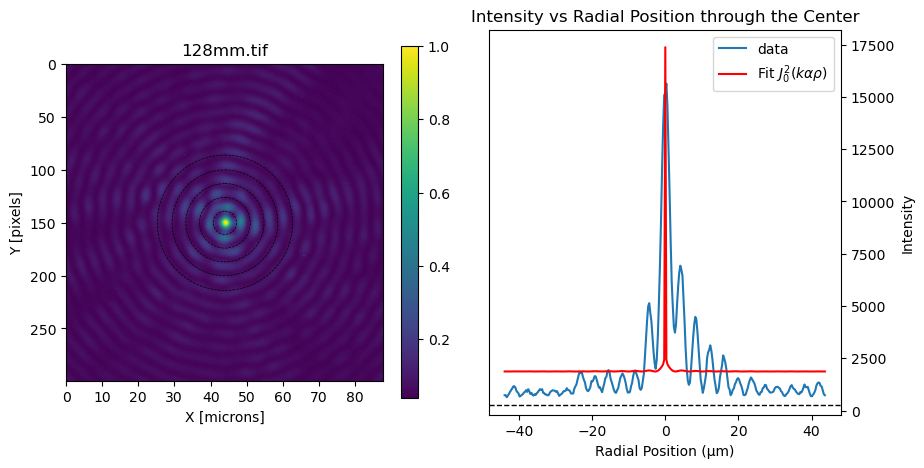

Annulus_1
Annulus_2
Annulus_3
Annulus_4


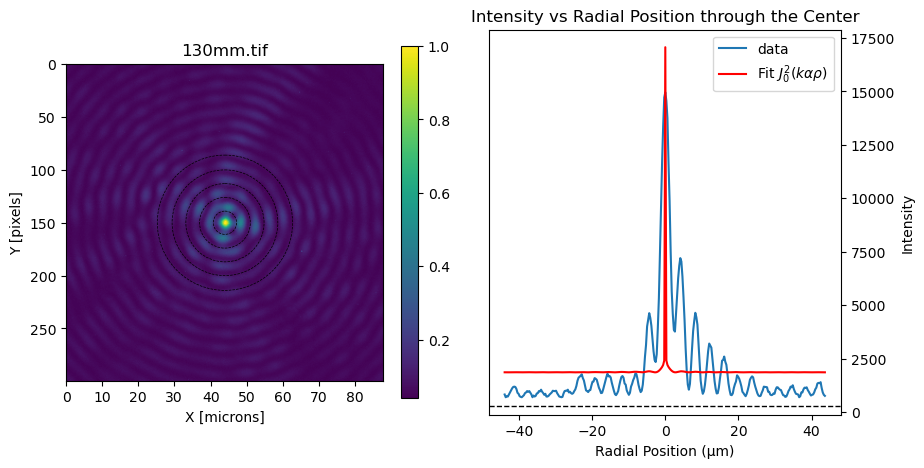

Annulus_1
Annulus_2
Annulus_3
Annulus_4


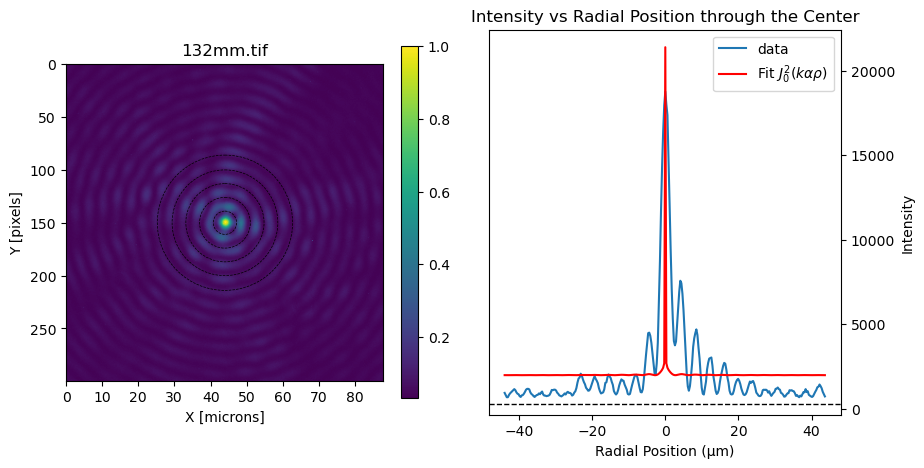

Annulus_1
Annulus_2
Annulus_3
Annulus_4


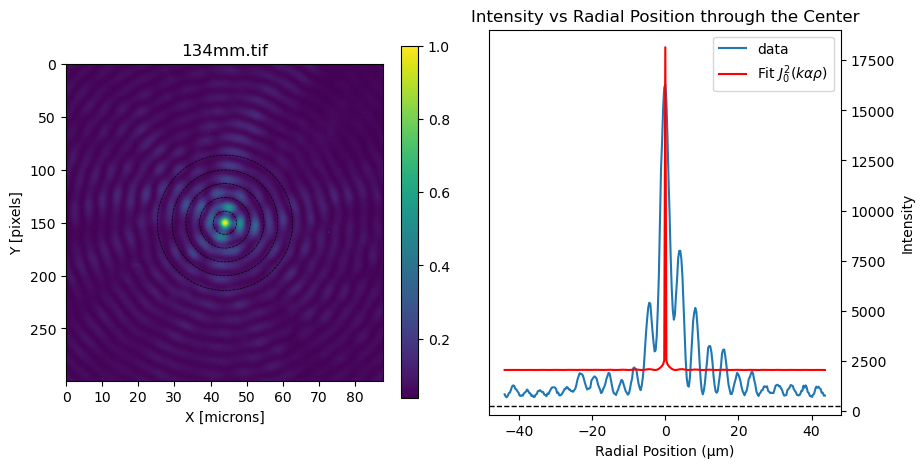

Annulus_1
Annulus_2
Annulus_3
Annulus_4


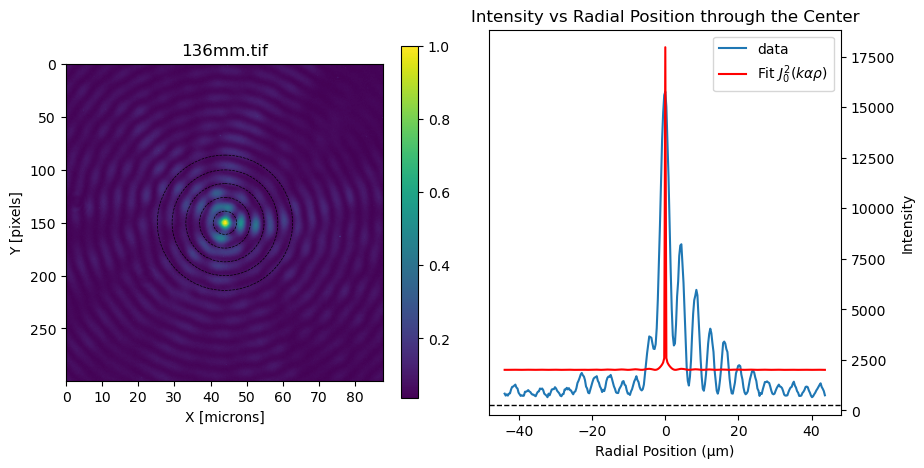

Annulus_1
Annulus_2
Annulus_3
Annulus_4


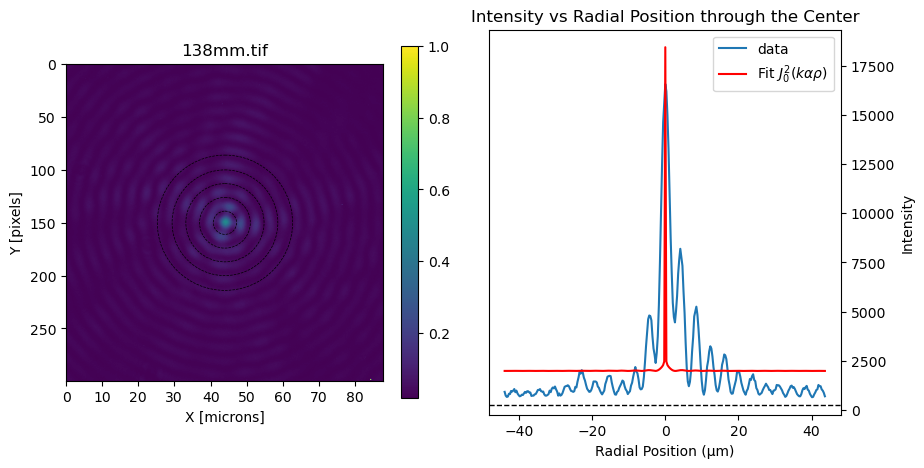

Annulus_1
Annulus_2
Annulus_3
Annulus_4


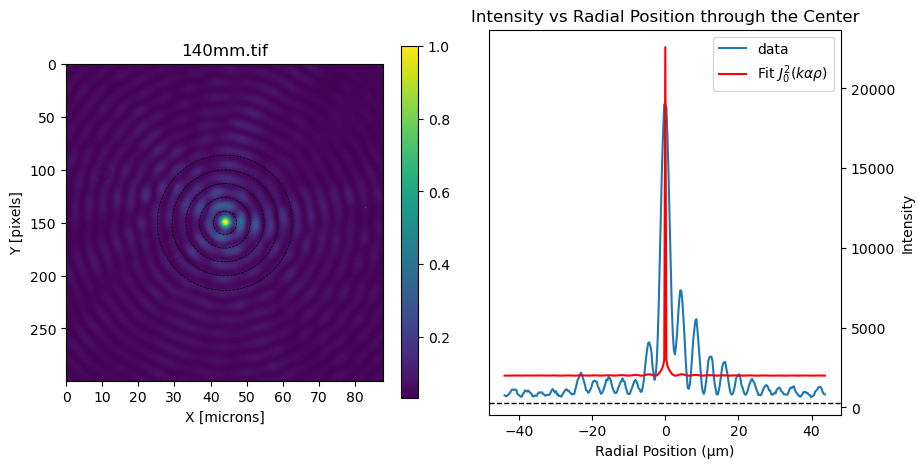

Annulus_1
Annulus_2
Annulus_3
Annulus_4


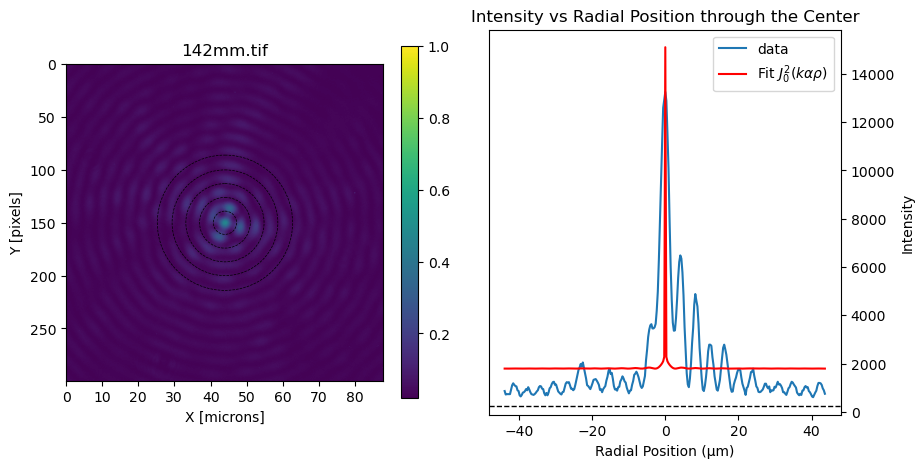

Annulus_1
Annulus_2
Annulus_3
Annulus_4


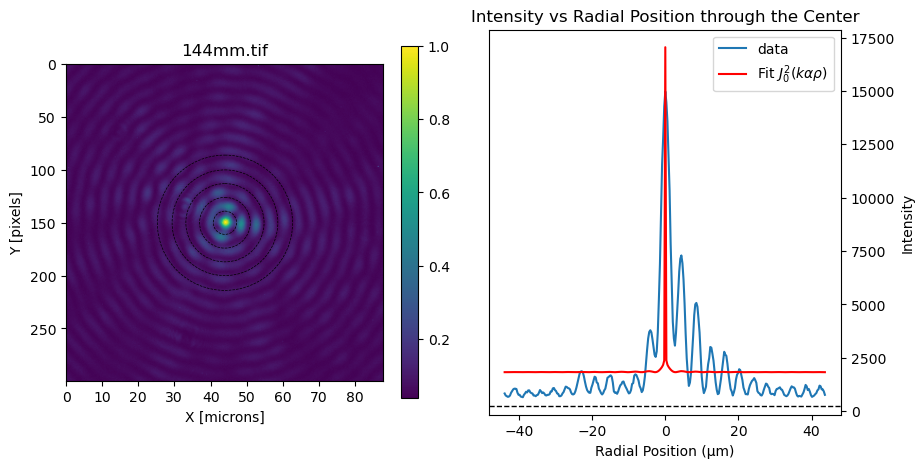

Annulus_1
Annulus_2
Annulus_3
Annulus_4


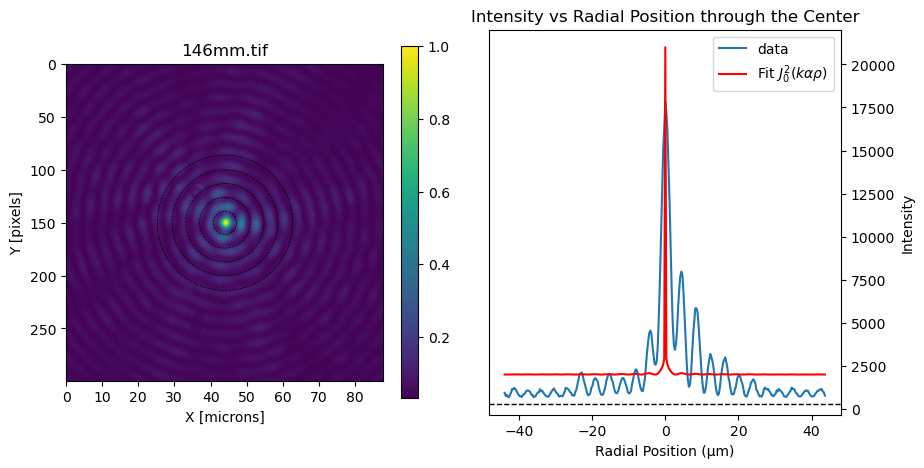

Annulus_1
Annulus_2
Annulus_3
Annulus_4


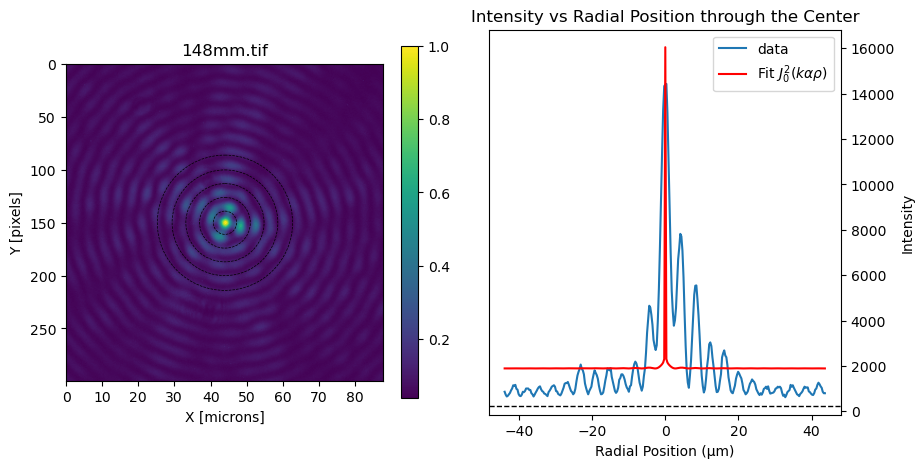

Annulus_1
Annulus_2
Annulus_3
Annulus_4


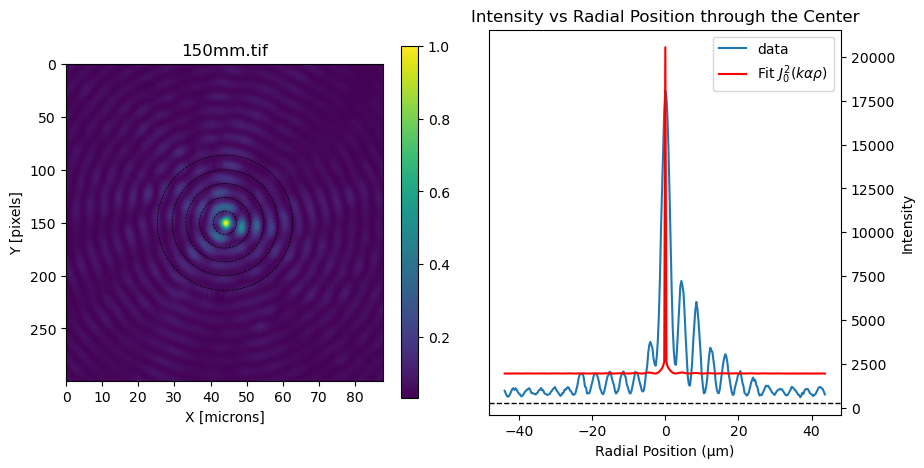

Annulus_1
Annulus_2
Annulus_3
Annulus_4


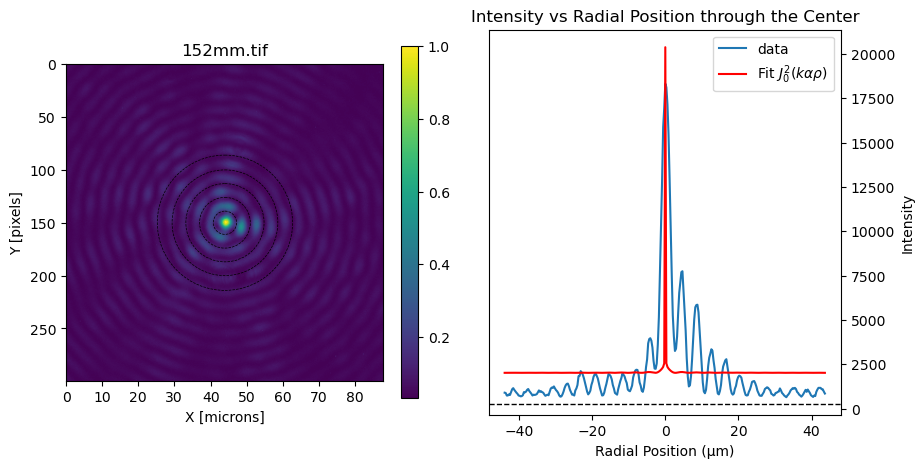

Annulus_1
Annulus_2
Annulus_3
Annulus_4


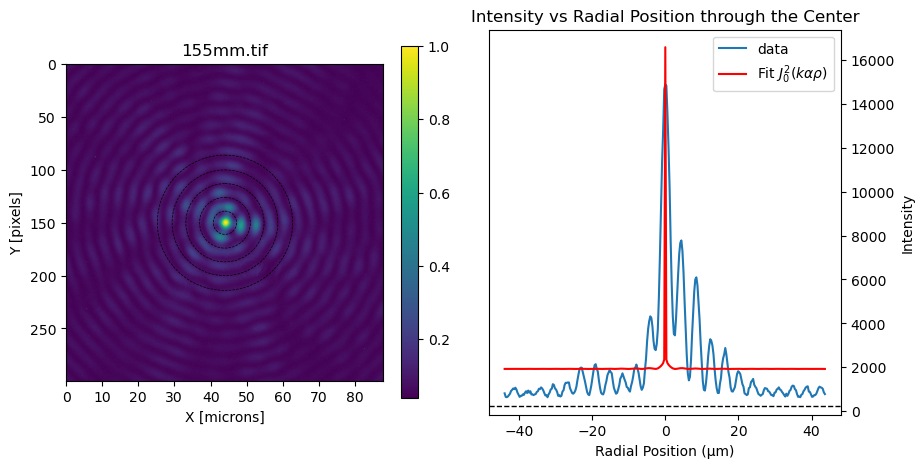

Annulus_1
Annulus_2
Annulus_3
Annulus_4


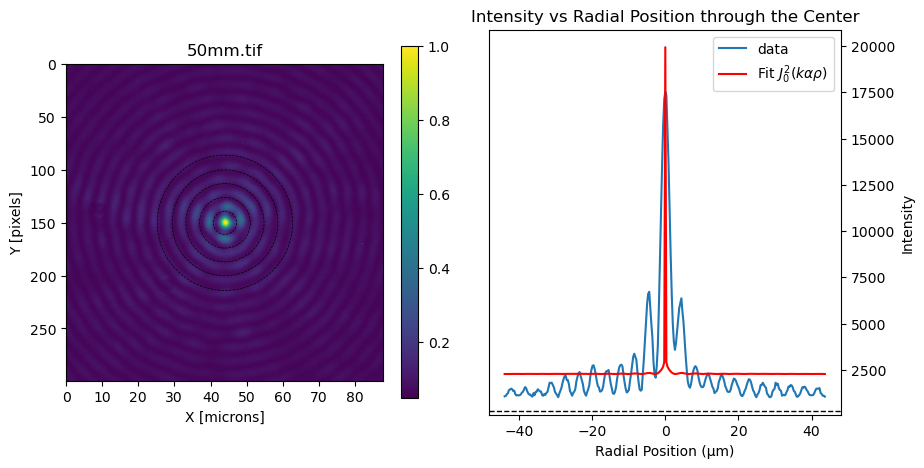

Annulus_1
Annulus_2
Annulus_3
Annulus_4


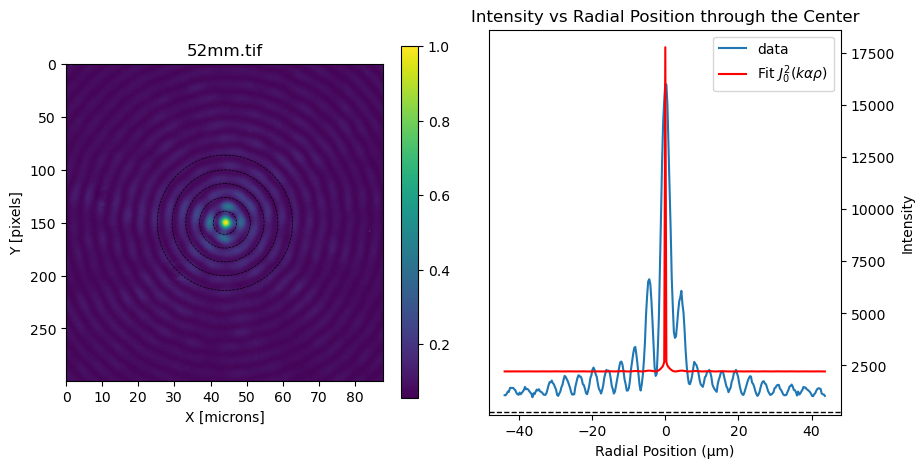

Annulus_1
Annulus_2
Annulus_3
Annulus_4


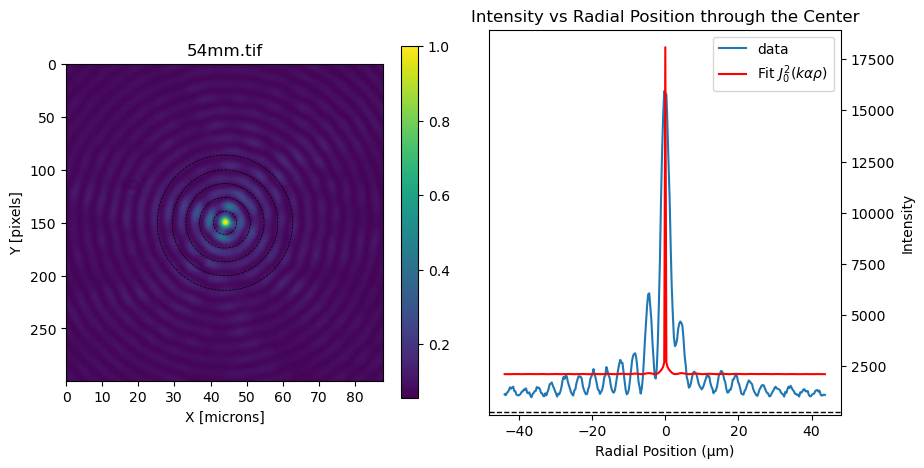

Annulus_1
Annulus_2
Annulus_3
Annulus_4
Error: Optimal parameters not found: Number of calls to function has reached maxfev = 1800.


TypeError: cannot unpack non-iterable NoneType object

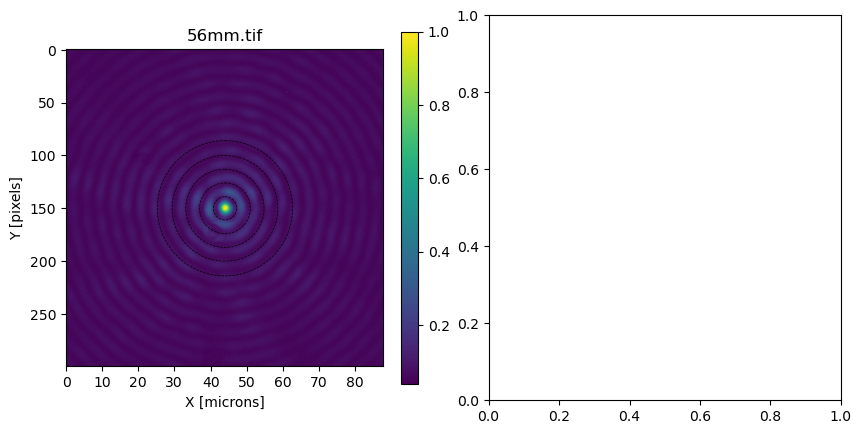

In [7]:
# Replace 'path_to_your_folder' with the actual path to your folder containing TIFF files
axi7degwithplug_folder_path = "/Volumes/LACIE/OXFORD/CALA_March_2024/PFS_laptop/240315axiscans/7degwithplug"

# Set the radius for the main circular region and the radii for additional circles
axi7degwithplug_circle_radius = 150
axi7degwithplug_circle_radii = [11, 24, 37, 50, 64]

# Get extracted numbers and results for all TIFF images in the folder
axi7degwithplug_mm, axi7degwithplug_results = show_tiff_images_with_sum_and_numbers(axi7degwithplug_folder_path, axi7degwithplug_circle_radius, axi7degwithplug_circle_radii)

/var/folders/0_/nrrxny_x54j3w76q939n8pth0000gn/T/ipykernel_2038/4240365136.py:149: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(tiff_file)


Annulus_1
Annulus_2
Annulus_3
Annulus_4


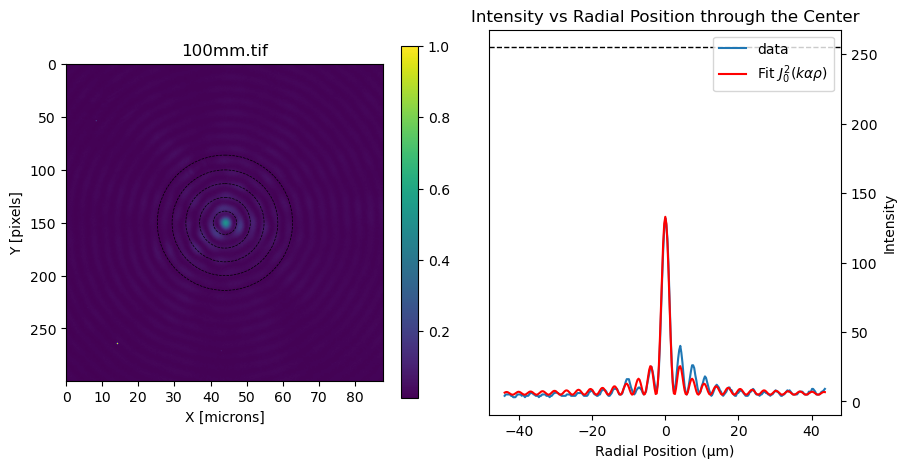

Annulus_1
Annulus_2
Annulus_3
Annulus_4


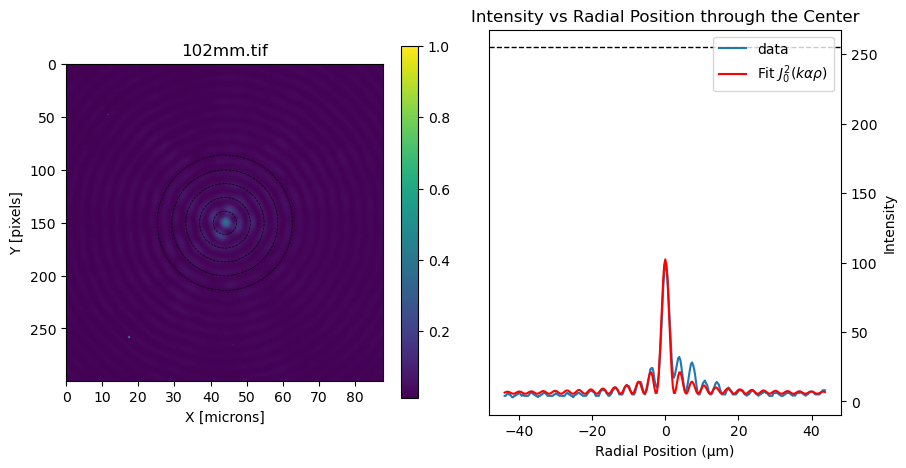

Annulus_1
Annulus_2
Annulus_3
Annulus_4


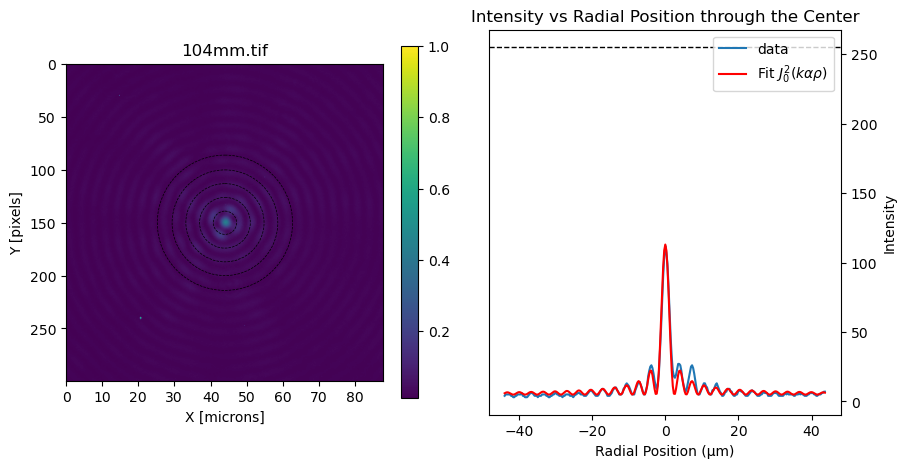

Annulus_1
Annulus_2
Annulus_3
Annulus_4


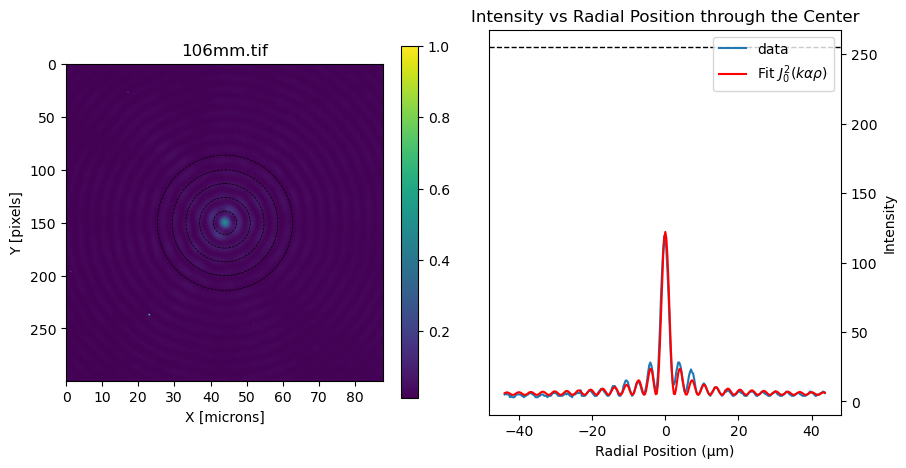

Annulus_1
Annulus_2
Annulus_3
Annulus_4


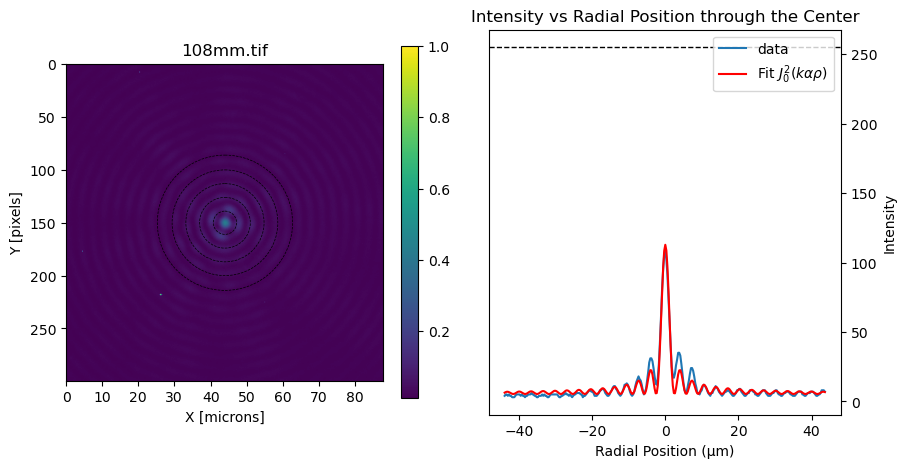

Annulus_1
Annulus_2
Annulus_3
Annulus_4


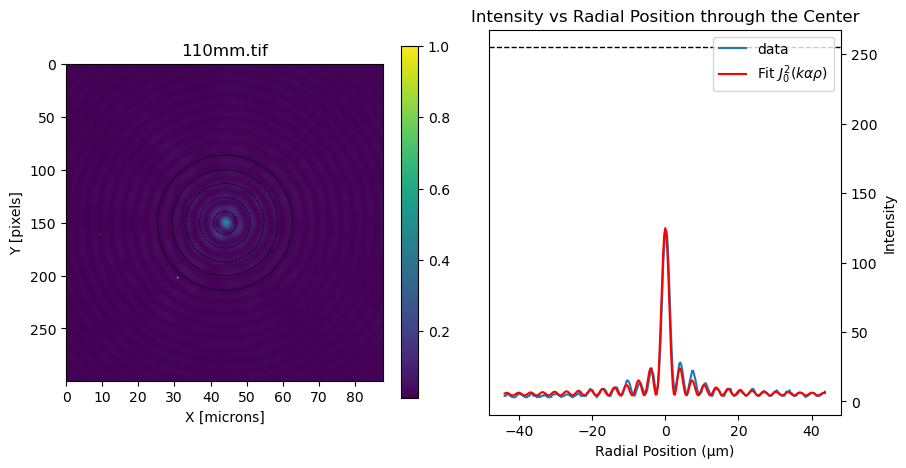

Annulus_1
Annulus_2
Annulus_3
Annulus_4


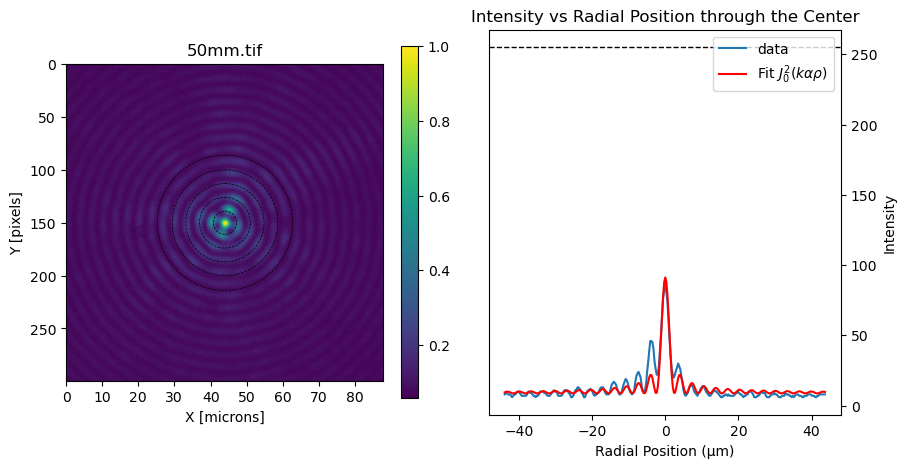

Annulus_1
Annulus_2
Annulus_3
Annulus_4


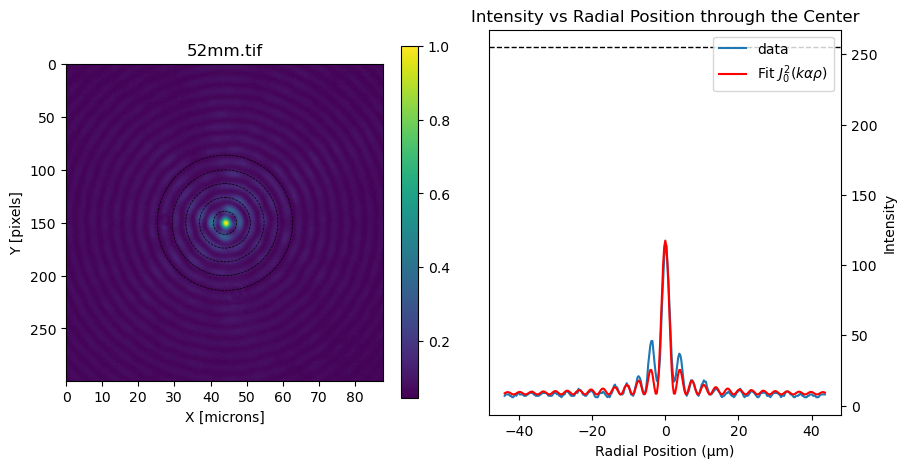

Annulus_1
Annulus_2
Annulus_3
Annulus_4


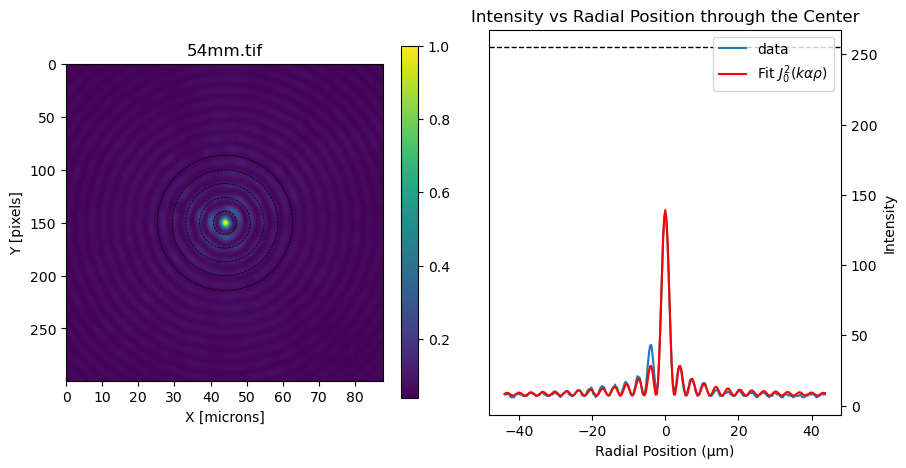

Annulus_1
Annulus_2
Annulus_3
Annulus_4


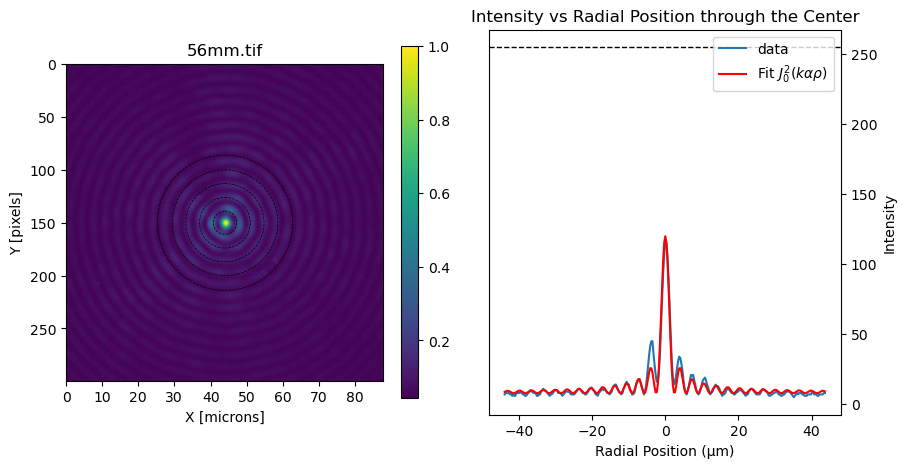

Annulus_1
Annulus_2
Annulus_3
Annulus_4


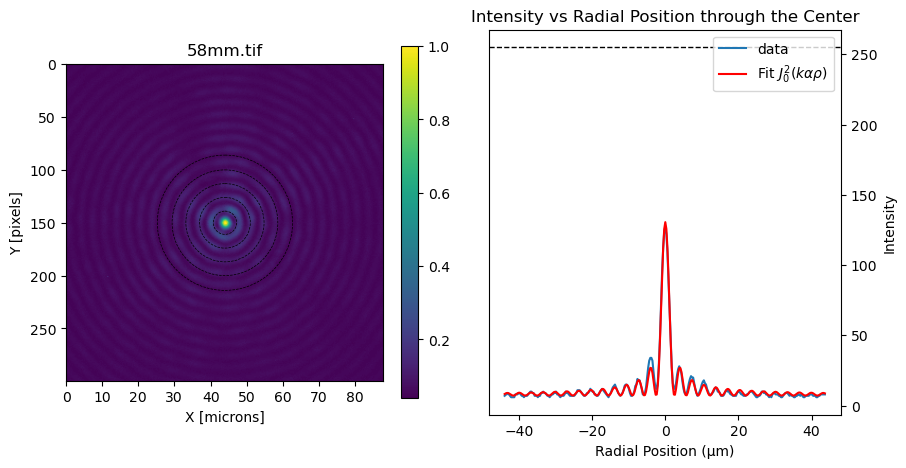

Annulus_1
Annulus_2
Annulus_3
Annulus_4


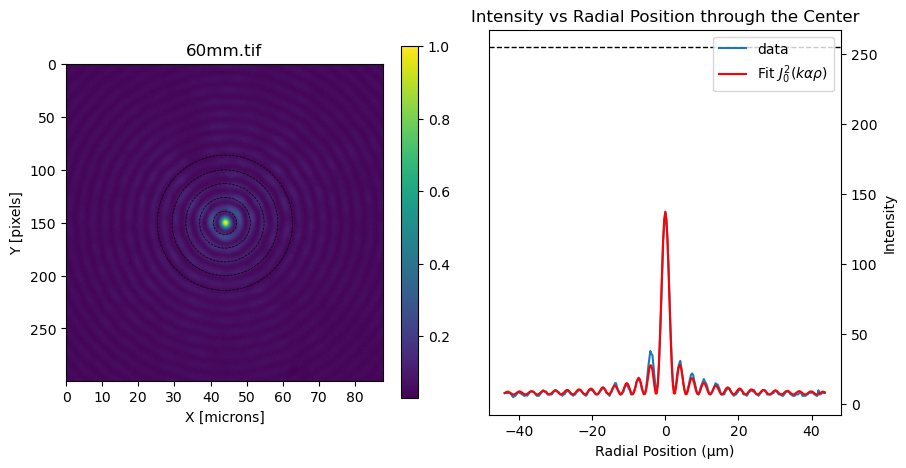

Annulus_1
Annulus_2
Annulus_3
Annulus_4


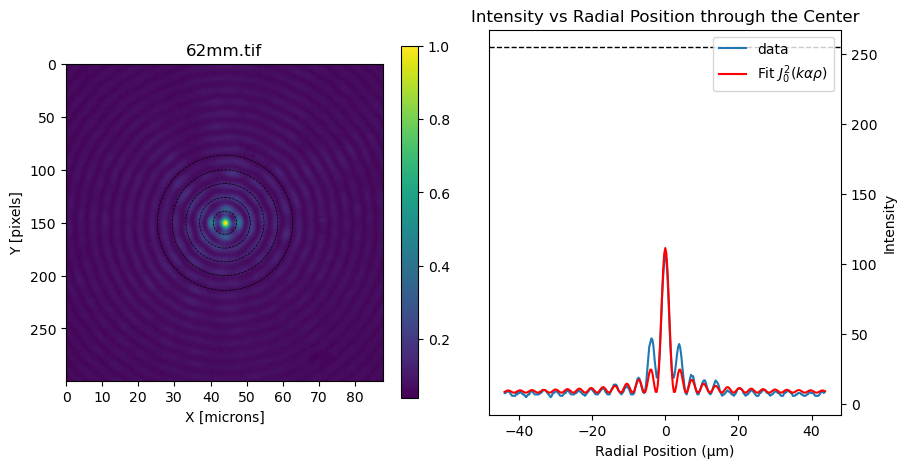

Annulus_1
Annulus_2
Annulus_3
Annulus_4


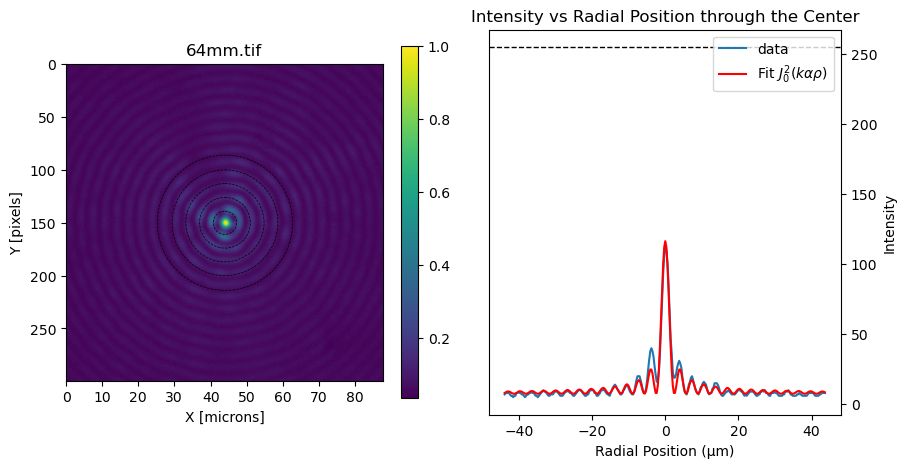

Annulus_1
Annulus_2
Annulus_3
Annulus_4


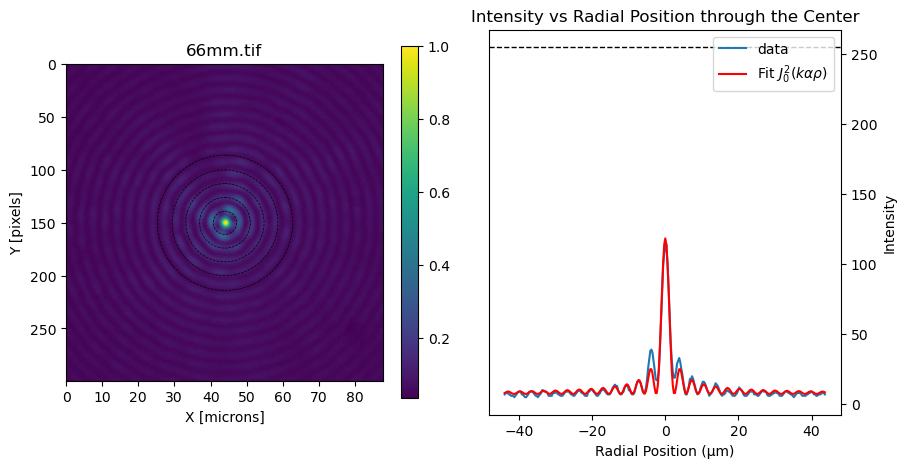

Annulus_1
Annulus_2
Annulus_3
Annulus_4


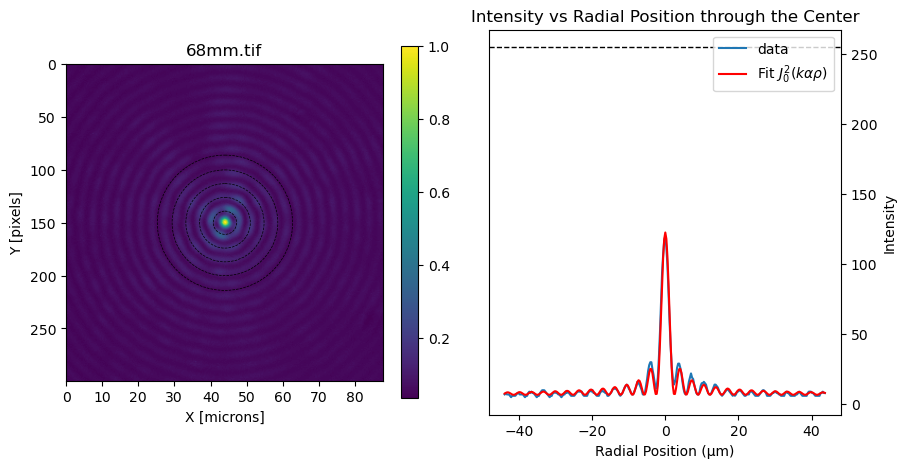

Annulus_1
Annulus_2
Annulus_3
Annulus_4


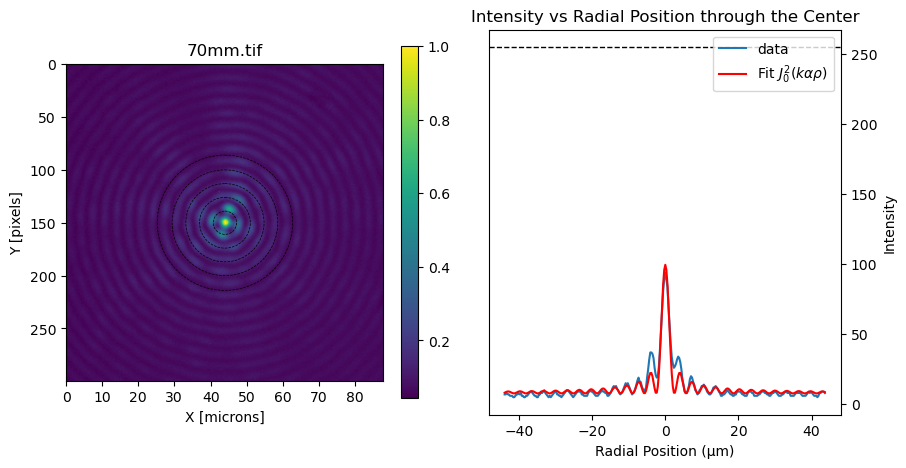

Annulus_1
Annulus_2
Annulus_3
Annulus_4


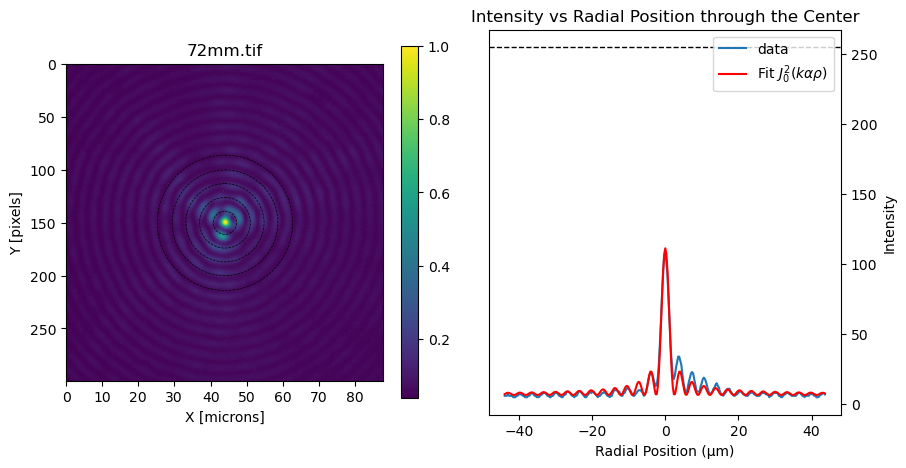

Annulus_1
Annulus_2
Annulus_3
Annulus_4


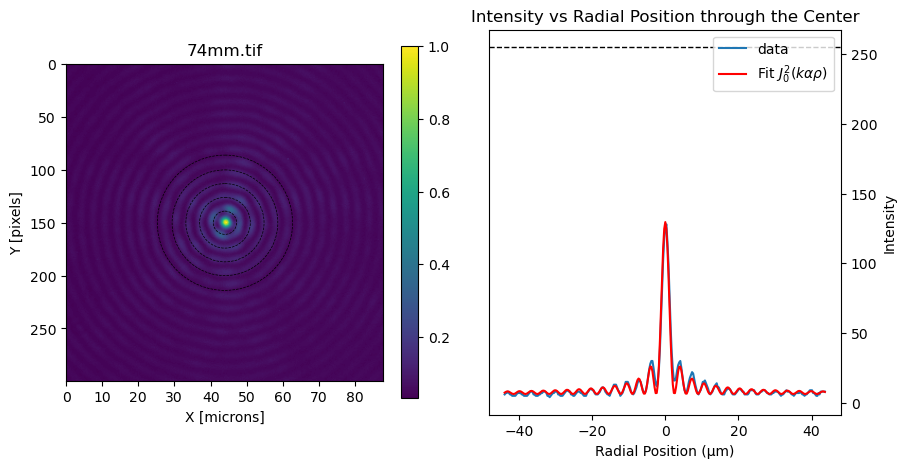

Annulus_1
Annulus_2
Annulus_3
Annulus_4


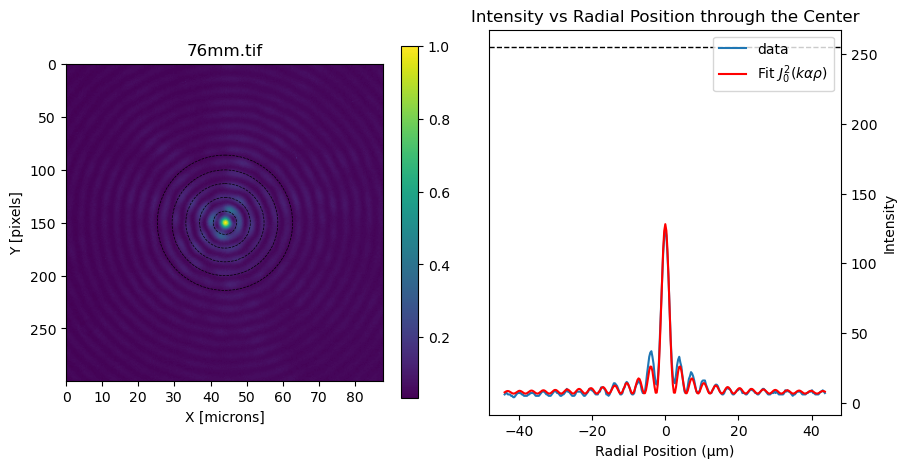

Annulus_1
Annulus_2
Annulus_3
Annulus_4


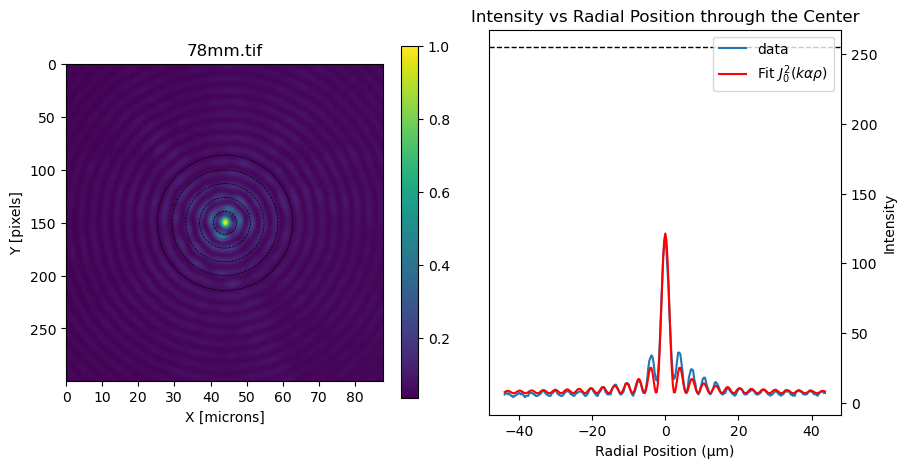

Annulus_1
Annulus_2
Annulus_3
Annulus_4


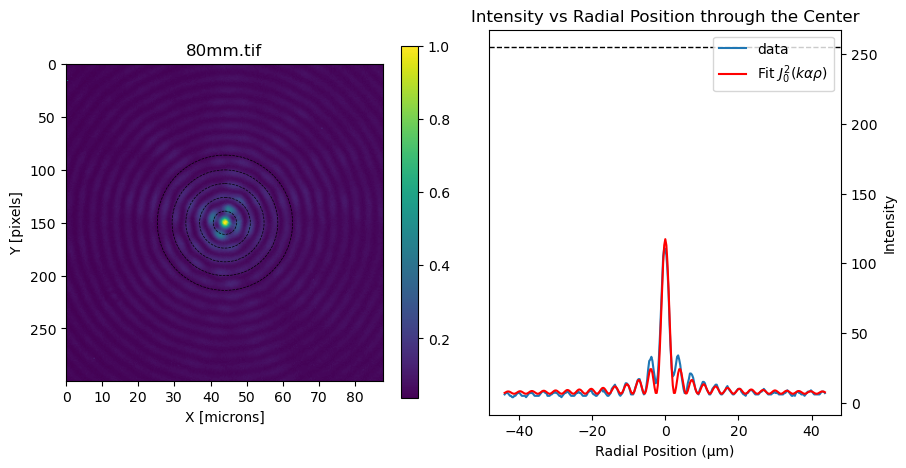

Annulus_1
Annulus_2
Annulus_3
Annulus_4


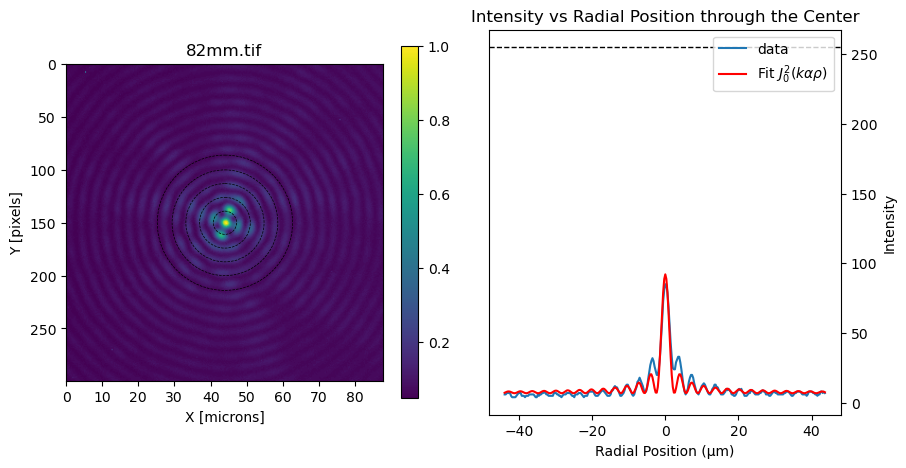

Annulus_1
Annulus_2
Annulus_3
Annulus_4


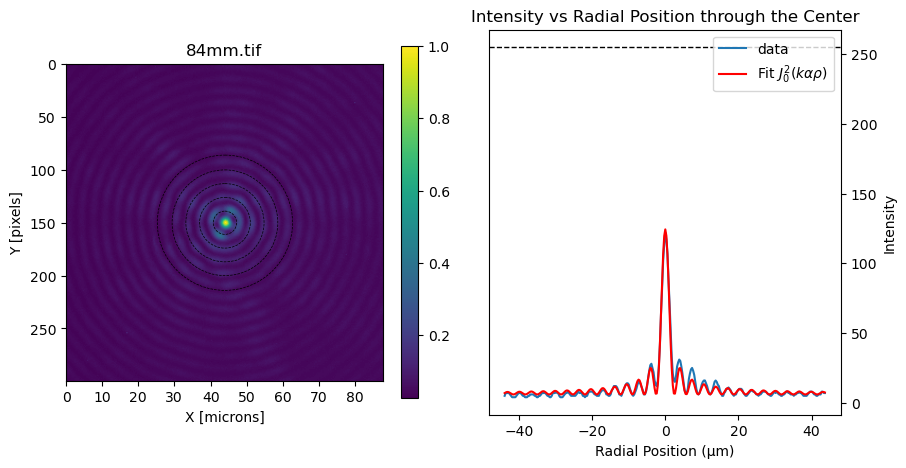

Annulus_1
Annulus_2
Annulus_3
Annulus_4


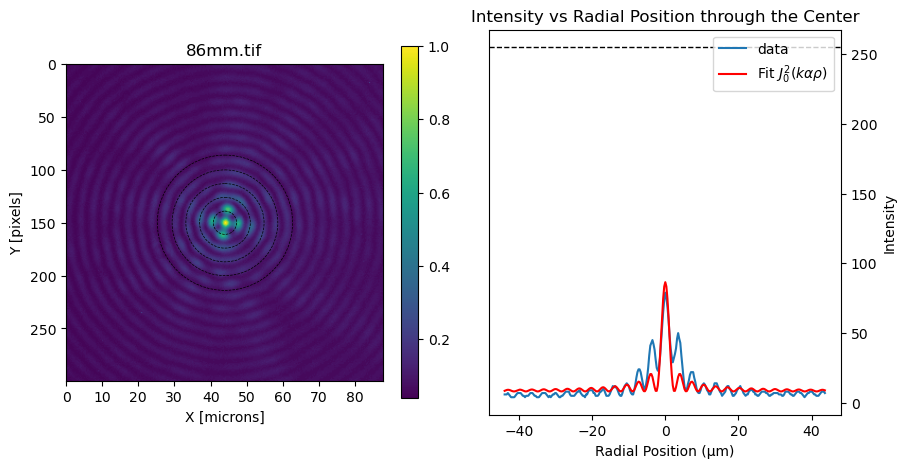

Annulus_1
Annulus_2
Annulus_3
Annulus_4


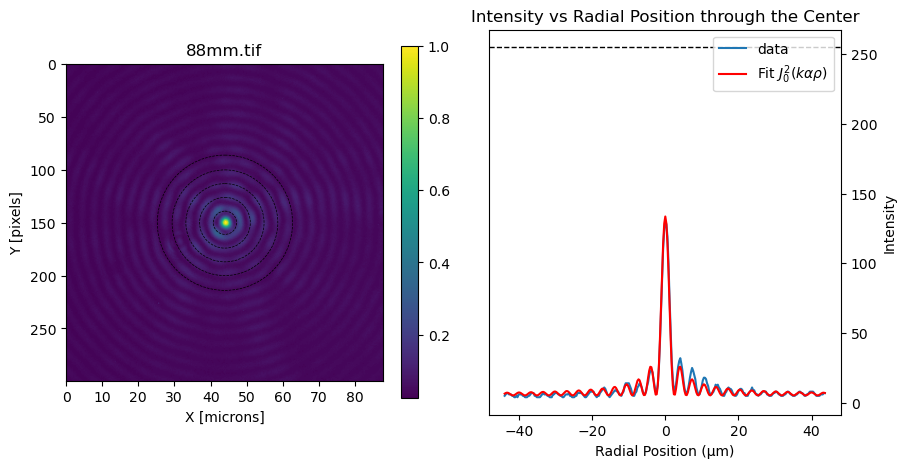

Annulus_1
Annulus_2
Annulus_3
Annulus_4


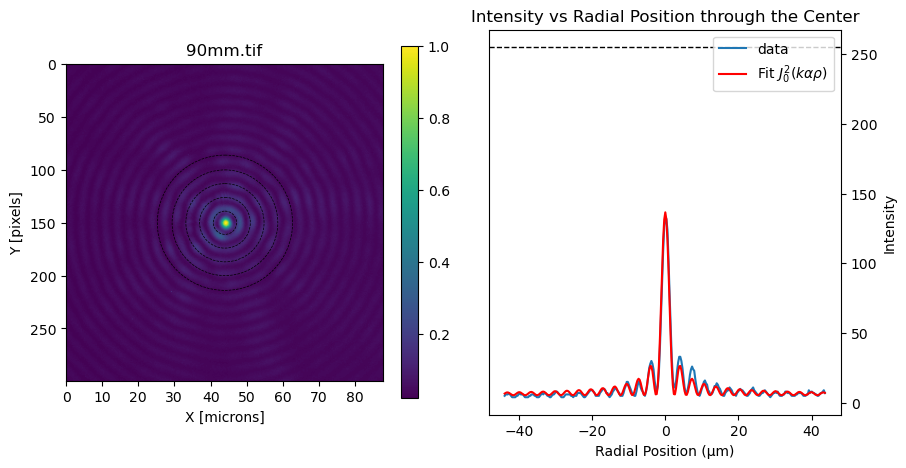

Annulus_1
Annulus_2
Annulus_3
Annulus_4


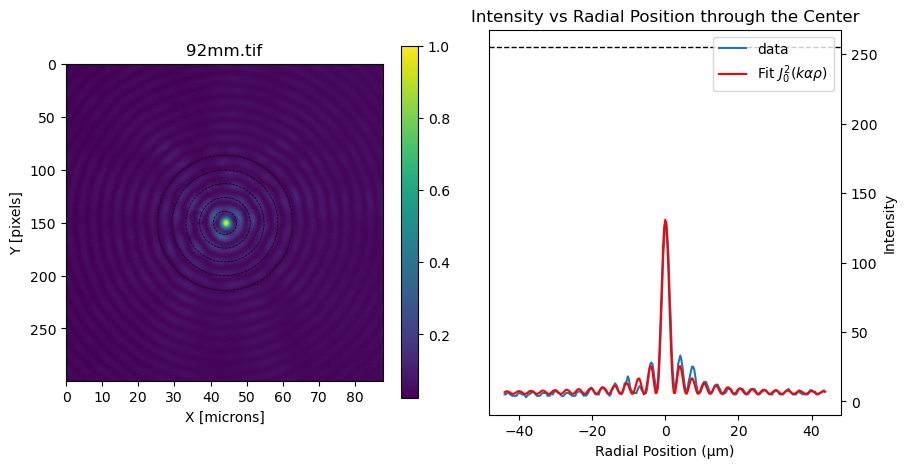

Annulus_1
Annulus_2
Annulus_3
Annulus_4


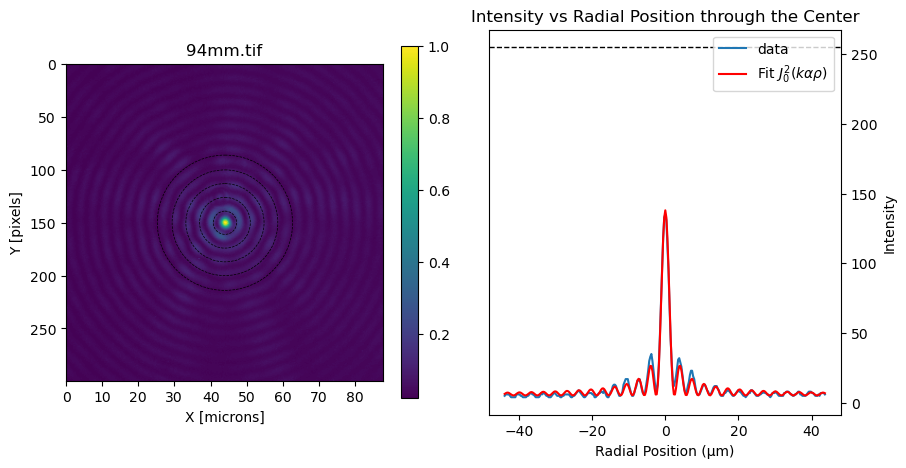

Annulus_1
Annulus_2
Annulus_3
Annulus_4


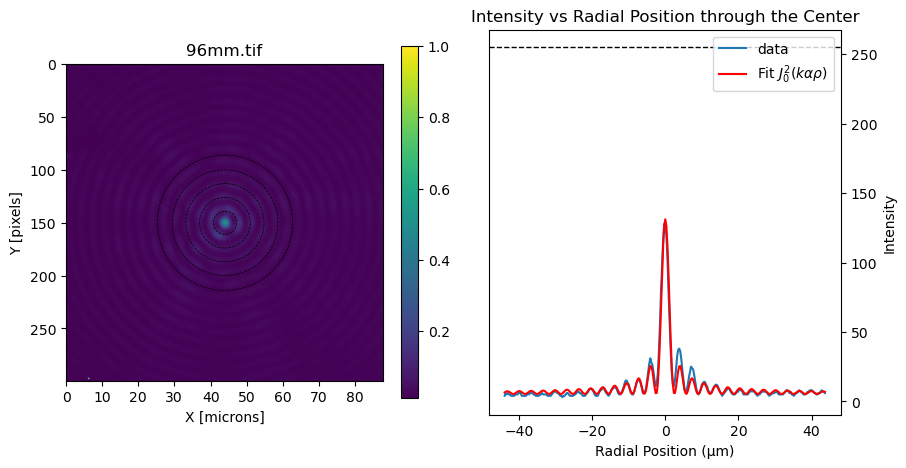

Annulus_1
Annulus_2
Annulus_3
Annulus_4


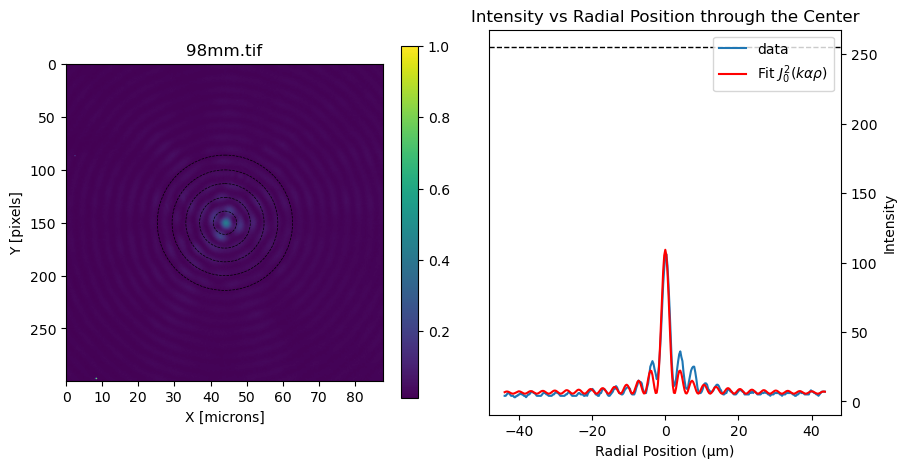

In [8]:
# Replace 'path_to_your_folder' with the actual path to your folder containing TIFF files
axi8degnoplug_BM550_folder_path = "/Volumes/LACIE/OXFORD/CALA_March_2024/PFS_laptop/240315axiscans/8degnoplug_BM550"

# Set the radius for the main circular region and the radii for additional circles
axi8degnoplug_BM550_circle_radius = 150
axi8degnoplug_BM550_circle_radii = [11, 24, 37, 50, 64]

# Get extracted numbers and results for all TIFF images in the folder
axi8degnoplug_BM550_mm, axi8degnoplug_BM550_results = show_tiff_images_with_sum_and_numbers(axi8degnoplug_BM550_folder_path, axi8degnoplug_BM550_circle_radius, axi8degnoplug_BM550_circle_radii)

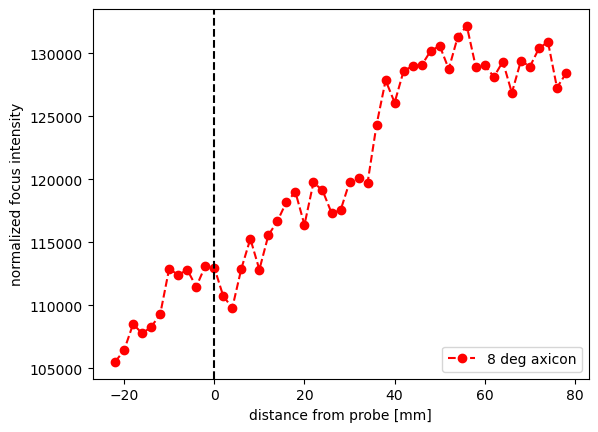

In [13]:
axi7degnoplug_sum_ROI, axi7degwithplug_sum_ROI, axi8degnoplug_sum_ROI, axi8degnoplug_BM550_sum_ROI = [], [],[],[]
for dict1 in axi7degnoplug_results:
    axi7degnoplug_sum_ROI.append(dict1['sum_ROI'])
for dict2 in axi8degnoplug_results:
    axi8degnoplug_sum_ROI.append(dict2['sum_ROI'])
#for dict3 in axi7degwithplug_results:
#    axi7degwithplug_sum_ROI.append(dict3['sum_ROI'])
for dict4 in axi8degnoplug_BM550_results:
    axi8degnoplug_BM550_sum_ROI.append(dict4['sum_ROI'])

plt.plot(np.flip(-axi8degnoplug_mm)-72, axi8degnoplug_sum_ROI, '--o',color='red',label='8 deg axicon')
plt.plot(np.flip(-axi8degnoplug_BM550_mm), axi8degnoplug_BM550_sum_ROI/(1.1*np.max(axi8degnoplug_BM550_sum_ROI)), '--o')
plt.plot(np.flip(-axi7degnoplug_mm)-72, axi7degnoplug_sum_ROI/np.max(axi7degnoplug_sum_ROI), '--o',color='blue',label='7 deg axicon')
#plt.plot(np.flip(-axi7degwithplug_mm-4), axi7degwithplug_sum_ROI/np.max(axi7degwithplug_sum_ROI), '--o')
plt.axvline(x=0,color='black',linestyle='dashed')

#plt.ylim(0,1.1)
plt.xlabel('distance from probe [mm]')
plt.ylabel('normalized focus intensity')
plt.legend()